<a href="https://colab.research.google.com/github/chetan-957/DV-final-project/blob/main/ps3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Exploring the Relationship Between Economic Development & Food Security**

### Selecting the Datasets (Why These Data?)
For this project, we are using two key datasets to explore the relationship between economic development & food security across countries.

### 📊 Datasets Used:

✅ FAOSTAT Food Balance Sheets (from FAO)

link: https://www.fao.org/faostat/en/#data/FBS

Covers food supply, production, imports/exports, and nutritional indicators.
Tracks food availability & consumption trends from 2010 to 2023.
Key variables: Food supply (kcal/capita), protein & fat supply, food losses, stock variation.


✅ World Bank WDI (World Development Indicators)

link: https://databank.worldbank.org/source/world-development-indicators#

Covers economic & trade data for all countries from 1980-2023.
Key variables: GDP per capita, GNI per capita, Trade as % of GDP, Gini Index (income inequality).


✅ Annual-CO2-Emissions

link:https://ourworldindata.org/co2-and-greenhouse-gas-emissions

Covers the Annual CO2 emissions over the years.


✅Methane Emissions Data

link:https://ourworldindata.org/grapher/methane-emissions?tab=table

Covers the Annual Methane emissions over the years.

✅Food price Inflation

link:https://data.worldbank.org/indicator/FP.CPI.TOTL.ZG?locations=MG

✅World shape file Zip

link:https://naciscdn.org/naturalearth/110m/cultural/ne_110m_admin_0_countries.zip

📌 Why These Data?
These datasets allow us to analyze global food security patterns while linking them to economic growth & inequality. This helps answer critical questions like:
1️⃣ Does GDP per capita correlate with better food security?
2️⃣ Do trade policies affect food supply fluctuations?
3️⃣ Is income inequality (Gini Index) linked to undernourishment?
4️⃣ How have food security trends evolved over time?



### 1️⃣ Research Focus
We aim to analyze how economic indicators (GDP per capita, GNI, Gini Index, Trade % of GDP) relate to food security metrics such as:

 ✅ Food availability (kcal/capita/day, food supply quantity)

 ✅ Nutritional intake (protein & fat supply per capita)

 ✅ Food production & trade (imports, exports, domestic supply)

 ✅ Sustainability (food losses & stock variation)


### 2️⃣ Key Research Questions (Unique Approach)
Instead of generic questions, we’re making this project unique by asking:

 1️⃣ Does economic growth lead to more diverse & nutritious food supply?
Example: Do wealthier countries consume more protein & fat than low-income ones?

 2️⃣ Does trade openness impact food security?
Example: Do highly import-dependent nations have more food variability or insecurity?

 3️⃣ Are countries with higher inequality (Gini Index) more vulnerable to food shortages?
Example: Do nations with high income gaps have poorer nutritional outcomes?

 4️⃣ Has food security improved over time as economies grow?
Example: Are there long-term trends (1980-2023) showing improvement in food access?


### **1️⃣ Load & Inspect Datasets**

In [94]:
import gdown
import pandas as pd

# Google Drive file ID
file_id = "1QB05L0xO9XE6l-U5NQNrAkWsUPxOZpF_"

# Direct download URL
download_url = f"https://drive.google.com/uc?id={file_id}"

# Define output file name
output_file = "FoodBalanceSheets_E_All_Data.csv"

# Download the file
gdown.download(download_url, output_file, quiet=False)

# Load CSV
faostat_df = pd.read_csv(output_file, encoding="latin1")

# Display sample data
faostat_df.head()


Downloading...
From (original): https://drive.google.com/uc?id=1QB05L0xO9XE6l-U5NQNrAkWsUPxOZpF_
From (redirected): https://drive.google.com/uc?id=1QB05L0xO9XE6l-U5NQNrAkWsUPxOZpF_&confirm=t&uuid=7cefaccb-fc7f-4495-b66a-407337efc743
To: /content/FoodBalanceSheets_E_All_Data.csv
100%|██████████| 119M/119M [00:01<00:00, 80.2MB/s]


,Area Code,Area Code (M49),Area,Item Code,Item Code (FBS),Item,Element Code,Element,Unit,Y2010,...,Y2019N,Y2020,Y2020F,Y2020N,Y2021,Y2021F,Y2021N,Y2022,Y2022F,Y2022N
0,2,'004,Afghanistan,2501,'S2501,Population,511,Total Population - Both sexes,1000 No,28189.67,...,NaN,38972.23,X,NaN,40099.46,X,NaN,41128.77,X,NaN
1,2,'004,Afghanistan,2901,'S2901,Grand Total,664,Food supply (kcal/capita/day),kcal/cap/d,2208.00,...,NaN,2266.00,E,NaN,2240.00,E,NaN,2243.00,E,NaN
2,2,'004,Afghanistan,2901,'S2901,Grand Total,661,Food supply (kcal),million Kcal,22714261.33,...,NaN,32236668.33,E,NaN,32780360.22,E,NaN,33679315.09,E,NaN
3,2,'004,Afghanistan,2901,'S2901,Grand Total,674,Protein supply quantity (g/capita/day),g/cap/d,65.76,...,NaN,63.37,E,NaN,61.22,E,NaN,61.03,E,NaN
4,2,'004,Afghanistan,2901,'S2901,Grand Total,671,Protein supply quantity (t),t,676666.08,...,NaN,901465.91,E,NaN,895962.82,E,NaN,916131.81,E,NaN


Using the `gdown` package, a dataset was downloaded from Google Drive using its unique file ID and saved as `"FoodBalanceSheets_E_All_Data.csv"`. The file was then loaded into a **pandas DataFrame** using `pd.read_csv()`, with `encoding="latin1"` to handle special characters. Finally, `head()` was used to display the first few rows, providing an overview of the dataset, which includes information on food supply, consumption, imports, exports, and production for different countries.

In [95]:
faostat_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 390590 entries, 0 to 390589
Data columns (total 48 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Area Code        390590 non-null  int64  
 1   Area Code (M49)  390590 non-null  object 
 2   Area             390590 non-null  object 
 3   Item Code        390590 non-null  int64  
 4   Item Code (FBS)  390590 non-null  object 
 5   Item             390590 non-null  object 
 6   Element Code     390590 non-null  int64  
 7   Element          390590 non-null  object 
 8   Unit             390590 non-null  object 
 9   Y2010            352794 non-null  float64
 10  Y2010F           352794 non-null  object 
 11  Y2010N           0 non-null       float64
 12  Y2011            352261 non-null  float64
 13  Y2011F           352261 non-null  object 
 14  Y2011N           0 non-null       float64
 15  Y2012            354469 non-null  float64
 16  Y2012F           354469 non-null  obje

In [96]:
# GitHub Raw File Link
github_url = "https://raw.githubusercontent.com/chetan-957/Data-Management-sp2025/main/P_Data_Extract_From_World_Development_Indicators.xlsx"

# Load WDI Excel file directly from GitHub
wdi_df = pd.read_excel(github_url, sheet_name="Data")

# Display sample data
wdi_df.tail()


,Country Name,Country Code,Series Name,Series Code,1980 [YR1980],1981 [YR1981],1982 [YR1982],1983 [YR1983],1984 [YR1984],1985 [YR1985],...,2014 [YR2014],2015 [YR2015],2016 [YR2016],2017 [YR2017],2018 [YR2018],2019 [YR2019],2020 [YR2020],2021 [YR2021],2022 [YR2022],2023 [YR2023]
4123,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4124,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4125,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4126,Data from database: World Development Indicators,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4127,Last Updated: 01/28/2025,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


The code downloads an Excel file from GitHub and loads the "Data" sheet into a **pandas DataFrame** using `pd.read_excel()`. The `tail()` function displays the last five rows, providing a quick overview of the dataset’s structure and contents.

In [97]:
wdi_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4128 entries, 0 to 4127
Data columns (total 48 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Country Name   4125 non-null   object
 1   Country Code   4123 non-null   object
 2   Series Name    4123 non-null   object
 3   Series Code    4123 non-null   object
 4   1980 [YR1980]  4123 non-null   object
 5   1981 [YR1981]  4123 non-null   object
 6   1982 [YR1982]  4123 non-null   object
 7   1983 [YR1983]  4123 non-null   object
 8   1984 [YR1984]  4123 non-null   object
 9   1985 [YR1985]  4123 non-null   object
 10  1986 [YR1986]  4123 non-null   object
 11  1987 [YR1987]  4123 non-null   object
 12  1988 [YR1988]  4123 non-null   object
 13  1989 [YR1989]  4123 non-null   object
 14  1990 [YR1990]  4123 non-null   object
 15  1991 [YR1991]  4123 non-null   object
 16  1992 [YR1992]  4123 non-null   object
 17  1993 [YR1993]  4123 non-null   object
 18  1994 [YR1994]  4123 non-null

### **2️⃣ Extract Relevant Columns**

In [98]:
# Select only relevant elements from FAOSTAT
faostat_selected_elements = [
    "Food supply (kcal/capita/day)", "Food supply quantity (kg/capita/yr)",
    "Protein supply quantity (g/capita/day)", "Fat supply quantity (g/capita/day)",
    "Production (tonnes)", "Import Quantity (tonnes)", "Export Quantity (tonnes)",
    "Stock Variation (tonnes)", "Domestic supply quantity (tonnes)", "Losses (tonnes)"
]

# Filter FAOSTAT dataset
faostat_filtered = faostat_df[faostat_df["Element"].isin(faostat_selected_elements)]
faostat_filtered = faostat_filtered[["Area", "Item", "Element"] + [col for col in faostat_df.columns if col.startswith("Y")]]
faostat_filtered = faostat_filtered.rename(columns={"Area": "Country", "Item": "Food Category", "Element": "Metric"})

# Extract relevant indicators from WDI
wdi_selected_indicators = ["NY.GDP.PCAP.CD", "NY.GNP.PCAP.CD", "SI.POV.GINI", "NE.TRD.GNFS.ZS"]

wdi_filtered = wdi_df[wdi_df["Series Code"].isin(wdi_selected_indicators)]
wdi_filtered = wdi_filtered.rename(columns={"Country Name": "Country", "Series Name": "Indicator"})

# Clean year columns (remove " [YRxxxx]" format)
wdi_filtered.columns = [col.split(" [YR")[0] if " [YR" in col else col for col in wdi_filtered.columns]


This code **filters and processes** relevant data from the FAOSTAT and WDI datasets for further analysis.

#### **FAOSTAT Data Processing**:
1. **Selecting Key Food Security Metrics**  
   - Filtering only relevant food-related indicators (e.g., **calories, protein, fat supply, production, imports, exports, stock variations, losses**).
2. **Filtering the FAOSTAT Dataset**  
   - Keeping only rows where the `"Element"` column matches the selected food security metrics.  
   - Retaining only country (`"Area"`), food category (`"Item"`), metric (`"Element"`), and all **yearly data columns (`Yxxxx`)**.
   - Renaming columns:  
     - `"Area"` → `"Country"`  
     - `"Item"` → `"Food Category"`  
     - `"Element"` → `"Metric"`

#### **WDI Data Processing**:
1. **Selecting Economic Indicators**  
   - Extracts **GDP per capita, GNI per capita, Gini Index (inequality), and Trade (% of GDP)** from the WDI dataset.
2. **Filtering the WDI Dataset**  
   - Keeping only rows where the `"Series Code"` matches the selected indicators.  
   - Renameing columns:  
     - `"Country Name"` → `"Country"`  
     - `"Series Name"` → `"Indicator"`
3. **Cleaning Year Column Names**  
   - Removed **"[YRxxxx]"** from column names to standardize the format.

This prepares both datasets for **merging and further analysis** on the relationship between economic development and food security.

### **3️⃣ Handle Missing Data**

In [99]:
# Drop metadata columns (e.g., "Y2010F", "Y2010N") from FAOSTAT
faostat_filtered = faostat_filtered[[col for col in faostat_filtered.columns if not col.endswith(("F", "N"))]]

# Convert year columns to numeric in FAOSTAT
year_cols_fao = [col for col in faostat_filtered.columns if col.startswith("Y")]
faostat_filtered[year_cols_fao] = faostat_filtered[year_cols_fao].apply(pd.to_numeric, errors='coerce')

# Replace ".." in WDI dataset with NaN and convert year columns to numeric
wdi_filtered.replace("..", pd.NA, inplace=True)
year_cols_wdi = [col for col in wdi_filtered.columns if col.isdigit()]
wdi_filtered[year_cols_wdi] = wdi_filtered[year_cols_wdi].apply(pd.to_numeric, errors='coerce')

# Check missing data summary
print("FAOSTAT Missing Data Summary:\n", faostat_filtered.isnull().sum())
print("WDI Missing Data Summary:\n", wdi_filtered.isnull().sum())


FAOSTAT Missing Data Summary:
 Country             0
Food Category       0
Metric              0
Y2010            8589
Y2011            8651
Y2012            8090
Y2013            8058
Y2014            6383
Y2015            6357
Y2016            6334
Y2017            6046
Y2018            6160
Y2019            2526
Y2020            2034
Y2021            1901
Y2022            1911
dtype: int64
WDI Missing Data Summary:
 Country           0
Country Code      0
Indicator         0
Series Code       0
1980            437
1981            430
1982            426
1983            422
1984            416
1985            408
1986            402
1987            389
1988            394
1989            382
1990            343
1991            340
1992            306
1993            311
1994            305
1995            278
1996            279
1997            280
1998            266
1999            272
2000            254
2001            265
2002            236
2003            233
2004            2

This code **cleans and processes** the FAOSTAT and WDI datasets by handling metadata, data types, and missing values.

#### **FAOSTAT Data Cleaning**:
1. **Removed Unnecessary Metadata Columns**  
   - Dropped columns ending with `"F"` or `"N"` (e.g., `"Y2010F"`, `"Y2010N"`) that contain metadata instead of actual values.
2. **Converted Year Columns to Numeric**  
   - Identifies all year columns (`"Yxxxx"`) and converts them to numeric format, coercing any errors to `NaN`.

#### **WDI Data Cleaning**:
1. **Handles Missing Values**  
   - Replaced `".."` (used as missing value placeholders) with `NaN`.
2. **Converted Year Columns to Numeric**  
   - Identifies columns with numeric year names and converts them to numeric format.

#### **Missing Data Check**:
- Printed the **count of missing values** in both datasets to identify gaps in the data before merging and analysis.

### **4️⃣ Standardize Country Names**

In [100]:
# Dictionary for FAOSTAT to WDI country name mapping
country_name_mapping = {
    "Bolivia (Plurinational State of)": "Bolivia", "Iran (Islamic Republic of)": "Iran",
    "United Republic of Tanzania": "Tanzania", "Venezuela (Bolivarian Republic of)": "Venezuela",
    "Republic of Korea": "Korea, Rep.", "Democratic People's Republic of Korea": "Korea, Dem. People's Rep.",
    "United States of America": "United States", "TÃ¼rkiye": "Turkey",
    "Democratic Republic of the Congo": "Congo, Dem. Rep.", "Congo": "Congo, Rep.",
    "CÃ´te d'Ivoire": "Côte d'Ivoire", "Iran": "Iran, Islamic Rep.", "Turkey": "Turkiye",
    "Venezuela": "Venezuela, RB"
}

# Apply the mapping
faostat_filtered["Country"] = faostat_filtered["Country"].replace(country_name_mapping)

# Remove non-country regions from FAOSTAT dataset
non_countries = {"Africa", "Asia", "Europe", "World", "Land Locked Developing Countries", "Small Island Developing States"}
faostat_filtered = faostat_filtered[~faostat_filtered["Country"].isin(non_countries)]


The above code **harmonizes country names** between FAOSTAT and WDI datasets and removes non-country regions.

#### **Country Name Standardization**:
1. **Created a Mapping Dictionary**  
   - Some country names in FAOSTAT differ from WDI (e.g., `"Bolivia (Plurinational State of)"` vs. `"Bolivia"`).  
   - The dictionary maps FAOSTAT country names to their WDI equivalents for consistency.
2. **Mapping**  
   - The `replace()` function updates the `"Country"` column in **FAOSTAT** to match WDI naming conventions.

#### **Removing Non-Country Entries**:
1. **Defined a Set of Non-Country Regions**  
   - Removes aggregate regions like `"Africa"`, `"Asia"`, `"Europe"`, `"World"`, and other non-country entities.
2. **Filtered Out These Entries**  
   - Uses `~faostat_filtered["Country"].isin(non_countries)` to **keep only actual countries**.

This ensures **consistent country names** across datasets and removes unnecessary regional aggregates before merging.

### **5️⃣ Merge FAOSTAT & WDI Data**

In [101]:
# Convert FAOSTAT from wide to long format
faostat_long = faostat_filtered.melt(id_vars=["Country", "Food Category", "Metric"],
                                     var_name="Year", value_name="Value")

# Clean Year column (remove "Y" prefix)
faostat_long["Year"] = faostat_long["Year"].str.replace("Y", "").astype(int)

# Convert WDI from wide to long format
wdi_long = wdi_filtered.melt(id_vars=["Country", "Indicator", "Series Code"], var_name="Year", value_name="Value")

# Ensure Year column is numeric
wdi_long = wdi_long[wdi_long["Year"].str.isnumeric()]
wdi_long["Year"] = wdi_long["Year"].astype(int)

# Use Outer Join to Keep All Years
merged_data = faostat_long.merge(wdi_long, on=["Country", "Year"], how="outer")

# Save the final merged dataset
merged_data.to_csv("Merged_FAOSTAT_WDI.csv", index=False)

# Display sample of merged dataset
print("Merged Dataset Sample:\n")
merged_data.head(5)


Merged Dataset Sample:



,Country,Food Category,Metric,Year,Value_x,Indicator,Series Code,Value_y
0,Afghanistan,NaN,NaN,1980,NaN,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN
1,Afghanistan,NaN,NaN,1980,NaN,"GNI per capita, Atlas method (current US$)",NY.GNP.PCAP.CD,NaN
2,Afghanistan,NaN,NaN,1980,NaN,Gini index,SI.POV.GINI,NaN
3,Afghanistan,NaN,NaN,1980,NaN,Trade (% of GDP),NE.TRD.GNFS.ZS,NaN
4,Afghanistan,NaN,NaN,1981,NaN,GDP per capita (current US$),NY.GDP.PCAP.CD,NaN


The above code **reshapes, merges, and saves** the FAOSTAT and WDI datasets into a single structured format.

#### **Reshaping FAOSTAT Data**:
1. **Converted from Wide to Long Format**  
   - Uses `melt()` to transform FAOSTAT data, where year columns (e.g., `"Y2010"`, `"Y2011"`) become a single `"Year"` column.
2. **Cleaned the `"Year"` Column**  
   - Removes the `"Y"` prefix and converts it to an integer format for consistency.

#### **Reshaping WDI Data**:
1. **Converted from Wide to Long Format**  
   - Uses `melt()` to transform WDI data, keeping `"Country"`, `"Indicator"`, and `"Series Code"`, while moving year data into a `"Year"` column.
2. **Ensured `"Year"` is Numeric**  
   - Removes any non-numeric values in `"Year"`, then converts it to an integer.

#### **Merging the Datasets**:
1. **Performed an Outer Join**  
   - Merges FAOSTAT and WDI data on `"Country"` and `"Year"` while keeping all available years using an **outer join**.

#### **Saving and Displaying Data**:
1. **Saved the Final Merged Dataset**  
   - Writes the cleaned and merged data into `"Merged_FAOSTAT_WDI.csv"`.
2. **Displays a Sample**  
   - Prints the first five rows to verify the merging process.

Now This final dataset is now structured for **further analysis on economic development and food security.**

In [102]:
# Pivot Economic Indicators to Columns (for WDI `Value_y`)
pivoted_wdi = merged_data.pivot_table(
    index=["Country", "Food Category", "Metric", "Year"],
    columns="Indicator",
    values="Value_y"
).reset_index()

# Pivot FAOSTAT Metrics (for `Value_x`)
pivoted_fao = merged_data[["Country", "Food Category", "Metric", "Year", "Value_x"]].drop_duplicates()

# Merge FAOSTAT and WDI pivoted data
improved_data = pd.merge(pivoted_fao, pivoted_wdi, on=["Country", "Food Category", "Metric", "Year"], how="left")

# Rename columns for better readability
improved_data.rename(columns={
    "GDP per capita (current US$)": "GDP per capita (US$)",
    "GNI per capita, Atlas method (current US$)": "GNI per capita (US$)",
    "Gini index": "Gini Index",
    "Trade (% of GDP)": "Trade (% of GDP)",
    "Value_x": "FAOSTAT Metric Value"
}, inplace=True)

# Save the cleaned CSV
improved_data.to_csv("Improved_Merged_Data.csv", index=False)

# Display sample of cleaned data
improved_data.head(20)



,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP)
0,Afghanistan,NaN,NaN,1980,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,NaN,NaN,1981,NaN,NaN,NaN,NaN,NaN
2,Afghanistan,NaN,NaN,1982,NaN,NaN,NaN,NaN,NaN
3,Afghanistan,NaN,NaN,1983,NaN,NaN,NaN,NaN,NaN
4,Afghanistan,NaN,NaN,1984,NaN,NaN,NaN,NaN,NaN
5,Afghanistan,NaN,NaN,1985,NaN,NaN,NaN,NaN,NaN
6,Afghanistan,NaN,NaN,1986,NaN,NaN,NaN,NaN,NaN
7,Afghanistan,NaN,NaN,1987,NaN,NaN,NaN,NaN,NaN
8,Afghanistan,NaN,NaN,1988,NaN,NaN,NaN,NaN,NaN
9,Afghanistan,NaN,NaN,1989,NaN,NaN,NaN,NaN,NaN


In [103]:
improved_data.tail(30)

,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP)
1209908,Zimbabwe,"Marine Fish, Other",Protein supply quantity (g/capita/day),2022,0.02,2040.552459,1960.0,NaN,64.763608
1209909,Zimbabwe,"Marine Fish, Other",Fat supply quantity (g/capita/day),2022,0.01,2040.552459,1960.0,NaN,64.763608
1209910,Zimbabwe,Crustaceans,Food supply quantity (kg/capita/yr),2022,0.00,2040.552459,1960.0,NaN,64.763608
1209911,Zimbabwe,Crustaceans,Food supply (kcal/capita/day),2022,0.00,2040.552459,1960.0,NaN,64.763608
1209912,Zimbabwe,Crustaceans,Protein supply quantity (g/capita/day),2022,0.00,2040.552459,1960.0,NaN,64.763608
1209913,Zimbabwe,Crustaceans,Fat supply quantity (g/capita/day),2022,0.00,2040.552459,1960.0,NaN,64.763608
1209914,Zimbabwe,Cephalopods,Food supply quantity (kg/capita/yr),2022,0.00,2040.552459,1960.0,NaN,64.763608
1209915,Zimbabwe,Cephalopods,Food supply (kcal/capita/day),2022,0.00,2040.552459,1960.0,NaN,64.763608
1209916,Zimbabwe,Cephalopods,Protein supply quantity (g/capita/day),2022,0.00,2040.552459,1960.0,NaN,64.763608
1209917,Zimbabwe,Cephalopods,Fat supply quantity (g/capita/day),2022,0.00,2040.552459,1960.0,NaN,64.763608


This code **reshapes, merges, and finalizes** the dataset for improved readability and analysis.

### **Reshaping WDI Data**:
1. **Pivoted Economic Indicators into Columns**  
   - Converted `Indicator` values (e.g., GDP, GNI, Gini Index, Trade % of GDP) into separate columns.
   - Used `pivot_table()` to restructure the dataset, making economic indicators easier to analyze.

### **Reshaping FAOSTAT Data**:
2. **Pivoted FAOSTAT Metrics**  
   - Extracted `"Value_x"` (FAOSTAT metric values) while keeping `"Country"`, `"Food Category"`, `"Metric"`, and `"Year"`.

### **Merging the Reshaped Data**:
3. **Combined FAOSTAT and WDI Data**  
   - Merged the pivoted FAOSTAT and WDI datasets using a **left join** to ensure all FAOSTAT values are retained.

### **Renaming Columns for Clarity**:
4. **Standardized Economic Indicator Names**  
   - Renamed columns for better readability:
     - `"GDP per capita (current US$)"` → `"GDP per capita (US$)"`
     - `"GNI per capita, Atlas method (current US$)"` → `"GNI per capita (US$)"`
     - `"Gini index"` → `"Gini Index"`
     - `"Trade (% of GDP)"` remains unchanged.
     - `"Value_x"` (FAOSTAT metric values) is renamed `"FAOSTAT Metric Value"`.

### **Saving and Displaying Final Data**:
5. **Saving the Cleaned Dataset**  
   - Writes the final structured dataset into `"Improved_Merged_Data.csv"`.
6. **Display a Sample**  
   - Prints the first 20 rows to verify the transformation.

This final dataset is **ready for statistical analysis** on the relationship between **economic indicators and food security metrics**.

In [104]:
# Load the Improved Merged Data
file_path = "Improved_Merged_Data.csv"

# Display dataset information
improved_data.info()

# Display first few rows
improved_data.head()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1209938 entries, 0 to 1209937
Data columns (total 9 columns):
 #   Column                Non-Null Count    Dtype  
---  ------                --------------    -----  
 0   Country               1209938 non-null  object 
 1   Food Category         1202574 non-null  object 
 2   Metric                1202574 non-null  object 
 3   Year                  1209938 non-null  int64  
 4   FAOSTAT Metric Value  1130794 non-null  float64
 5   GDP per capita (US$)  909344 non-null   object 
 6   GNI per capita (US$)  896423 non-null   object 
 7   Gini Index            361877 non-null   object 
 8   Trade (% of GDP)      821360 non-null   object 
dtypes: float64(1), int64(1), object(7)
memory usage: 83.1+ MB


,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP)
0,Afghanistan,NaN,NaN,1980,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,NaN,NaN,1981,NaN,NaN,NaN,NaN,NaN
2,Afghanistan,NaN,NaN,1982,NaN,NaN,NaN,NaN,NaN
3,Afghanistan,NaN,NaN,1983,NaN,NaN,NaN,NaN,NaN
4,Afghanistan,NaN,NaN,1984,NaN,NaN,NaN,NaN,NaN


The above code loads the **final cleaned dataset** (`"Improved_Merged_Data.csv"`) into a pandas DataFrame. The `info()` function provides a summary of columns, data types, and missing values, while `head()` displays the first few rows to verify the structure and correctness of the merged FAOSTAT and WDI data.

In [105]:
# Load the dataset from Colab's file path
file_path = "/content/Improved_Merged_Data.csv"
df = pd.read_csv(file_path)

# Convert 'Year' column to numeric (in case it is stored as a string)
df['Year'] = pd.to_numeric(df['Year'], errors='coerce')

# Filter dataset to only include data from 2010 onwards
df_filtered = df[df['Year'] >= 2010]

# Drop rows with missing values in key columns (Food Security & Economic Indicators)
key_columns = [
    'FAOSTAT Metric Value', 'GDP per capita (US$)', 'GNI per capita (US$)', 'Gini Index', 'Trade (% of GDP)'
]
df_filtered = df_filtered.dropna(subset=key_columns, how='all')

# Save the cleaned dataset in Colab
filtered_file_path = "/content/Filtered_Improved_Merged_Data_2010_Onwards.csv"
df_filtered.to_csv(filtered_file_path, index=False)

# Display first 10 rows of the filtered dataset
df_filtered.head(10)



,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP)
30,Afghanistan,Grand Total,Food supply (kcal/capita/day),2010,2208.00,560.621505,530.0,NaN,NaN
31,Afghanistan,Grand Total,Protein supply quantity (g/capita/day),2010,65.76,560.621505,530.0,NaN,NaN
32,Afghanistan,Grand Total,Fat supply quantity (g/capita/day),2010,38.06,560.621505,530.0,NaN,NaN
33,Afghanistan,Vegetal Products,Food supply (kcal/capita/day),2010,2008.00,560.621505,530.0,NaN,NaN
34,Afghanistan,Vegetal Products,Protein supply quantity (g/capita/day),2010,53.30,560.621505,530.0,NaN,NaN
35,Afghanistan,Vegetal Products,Fat supply quantity (g/capita/day),2010,24.92,560.621505,530.0,NaN,NaN
36,Afghanistan,Animal Products,Food supply (kcal/capita/day),2010,200.00,560.621505,530.0,NaN,NaN
37,Afghanistan,Animal Products,Protein supply quantity (g/capita/day),2010,12.46,560.621505,530.0,NaN,NaN
38,Afghanistan,Animal Products,Fat supply quantity (g/capita/day),2010,13.14,560.621505,530.0,NaN,NaN
39,Afghanistan,Cereals - Excluding Beer,Food supply quantity (kg/capita/yr),2010,202.73,560.621505,530.0,NaN,NaN


This code **loads, cleans, and filters** the dataset for analysis from 2010 onward.

1. **Loading the dataset** (`"Improved_Merged_Data.csv"`) and ensures the `"Year"` column is numeric.  
2. **Filtered the data** to include only records from **2010 onwards** for recent trends.  
3. **Dropped the rows with missing values** in key columns (`FAOSTAT metrics & economic indicators`).  
4. **Saving the cleaned dataset** as `"Filtered_Improved_Merged_Data_2010_Onwards.csv"`.  
5. **Displaying the first 10 rows** to verify the filtering process.

In [106]:
# Check missing values and percentage
missing_data = df_filtered.isnull().sum()
missing_percentage = (missing_data / len(df_filtered)) * 100

# Display missing value summary
print("Missing Data Summary:\n", pd.DataFrame({
    'Missing Values': missing_data,
    'Percentage (%)': missing_percentage
}))


Missing Data Summary:
                       Missing Values  Percentage (%)
Country                            0        0.000000
Food Category                      0        0.000000
Metric                             0        0.000000
Year                               0        0.000000
FAOSTAT Metric Value           58954        4.955167
GDP per capita (US$)          280404       23.568352
GNI per capita (US$)          293325       24.654381
Gini Index                    827871       69.583727
Trade (% of GDP)              368388       30.963532


The above code **analyzes missing values** in the filtered dataset.  

1. **Calculating Missing Values**  
   - Used `isnull().sum()` to count missing values in each column.  

2. **Computed Missing Percentage**  
   - Divided the missing count by the total number of rows and multiplies by 100 to get the percentage.  

3. **Displaying the Summary**  
   - Printed a **DataFrame** showing both the **number and percentage of missing values** for each column, helping identify gaps in the data.

In [107]:
# Impute missing values for economic indicators with country-level median
df_filtered['GDP per capita (US$)'] = df_filtered.groupby('Country')['GDP per capita (US$)'].transform(
    lambda x: x.fillna(x.median())
)
df_filtered['GNI per capita (US$)'] = df_filtered.groupby('Country')['GNI per capita (US$)'].transform(
    lambda x: x.fillna(x.median())
)
df_filtered['Gini Index'] = df_filtered.groupby('Country')['Gini Index'].transform(
    lambda x: x.fillna(x.median())
)
df_filtered['Trade (% of GDP)'] = df_filtered.groupby('Country')['Trade (% of GDP)'].transform(
    lambda x: x.fillna(x.median())
)

# Impute missing values for food security metrics with category-level median
df_filtered['FAOSTAT Metric Value'] = df_filtered.groupby(['Food Category', 'Metric'])['FAOSTAT Metric Value'].transform(
    lambda x: x.fillna(x.median())
)
df_filtered.head(5)

,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP)
30,Afghanistan,Grand Total,Food supply (kcal/capita/day),2010,2208.00,560.621505,530.0,NaN,51.411716
31,Afghanistan,Grand Total,Protein supply quantity (g/capita/day),2010,65.76,560.621505,530.0,NaN,51.411716
32,Afghanistan,Grand Total,Fat supply quantity (g/capita/day),2010,38.06,560.621505,530.0,NaN,51.411716
33,Afghanistan,Vegetal Products,Food supply (kcal/capita/day),2010,2008.00,560.621505,530.0,NaN,51.411716
34,Afghanistan,Vegetal Products,Protein supply quantity (g/capita/day),2010,53.30,560.621505,530.0,NaN,51.411716


The above code **fills missing values** in the dataset using the median values at different levels.

### **Imputing Missing Economic Indicators**:
1. **Filled missing values for GDP, GNI, Gini Index, and Trade (% of GDP)**  
   - Used `groupby('Country')` to compute the **country-level median** for each indicator.  
   - Applied `.transform(lambda x: x.fillna(x.median()))` to **replace missing values** with the median for that country.

### **Imputing Missing Food Security Metrics**:
2. **Filling missing values for FAOSTAT metrics**  
   - Used `groupby(['Food Category', 'Metric'])` to compute the **median value for each food category and metric**.  
   - Missing values are replaced with the corresponding **category-level median**.

### **Final Check**:
3. **Displays the first five rows** to verify that missing values have been imputed correctly.

In [108]:
# Drop rows where missing values still persist
df_cleaned = df_filtered.dropna()

# Save cleaned dataset
df_cleaned.to_csv("/content/Cleaned_Improved_Merged_Data_2010_Onwards.csv", index=False)
print("Cleaned data saved successfully.")
df_filtered.head(5)

Cleaned data saved successfully.


,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP)
30,Afghanistan,Grand Total,Food supply (kcal/capita/day),2010,2208.00,560.621505,530.0,NaN,51.411716
31,Afghanistan,Grand Total,Protein supply quantity (g/capita/day),2010,65.76,560.621505,530.0,NaN,51.411716
32,Afghanistan,Grand Total,Fat supply quantity (g/capita/day),2010,38.06,560.621505,530.0,NaN,51.411716
33,Afghanistan,Vegetal Products,Food supply (kcal/capita/day),2010,2008.00,560.621505,530.0,NaN,51.411716
34,Afghanistan,Vegetal Products,Protein supply quantity (g/capita/day),2010,53.30,560.621505,530.0,NaN,51.411716


The code **removes any remaining missing values** using `dropna()` and saves the fully cleaned dataset as `"Cleaned_Improved_Merged_Data_2010_Onwards.csv"`. It then prints a confirmation message and displays the first five rows to verify the final cleaned data.

### **Average Food Metrics Across Food Categories**

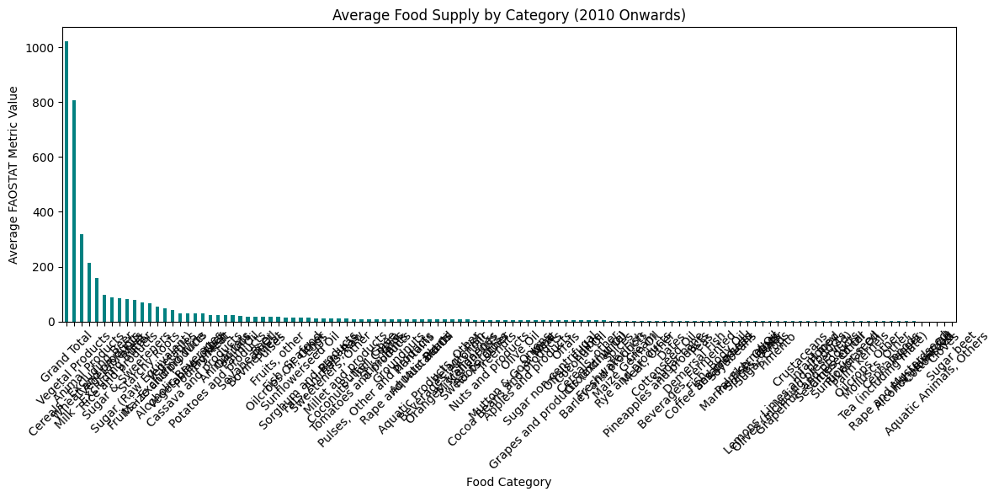

In [109]:
import matplotlib.pyplot as plt
# Group by Food Category and calculate mean for food metrics
food_metrics = df_filtered.groupby('Food Category')['FAOSTAT Metric Value'].mean().sort_values(ascending=False)

# Bar plot for food supply across categories
plt.figure(figsize=(12, 6))
food_metrics.plot(kind='bar', color='teal')
plt.title("Average Food Supply by Category (2010 Onwards)")
plt.ylabel("Average FAOSTAT Metric Value")
plt.xlabel("Food Category")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


**Food Categories with High Supply:**

**Categories like Cereals** - Excluding Beer or Wheat and Products are likely to dominate food supply, as they form staple diets for many countries.
Animal Products and Vegetal Products may show moderate contributions, with Animal Products contributing more to protein and fat availability.

**Food Categories with Low Supply:**
Categories like Barley and Products or Aquatic Animals may show low average supply, as they are consumed in smaller quantities or in specific regions.
This highlights the diversity of food supply and indicates which categories are staples vs. supplementary.



### **Correlation Between Economic Indicators and Food Metrics**

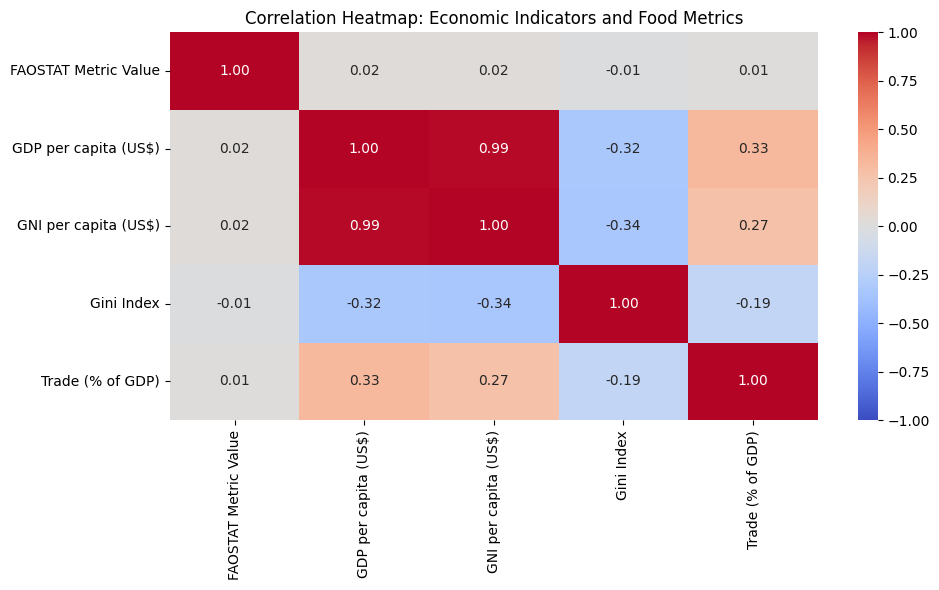

In [110]:
import seaborn as sns
# Subset for correlations
correlation_data = df_filtered[['FAOSTAT Metric Value', 'GDP per capita (US$)', 'GNI per capita (US$)', 'Gini Index', 'Trade (% of GDP)']]
correlation_matrix = correlation_data.corr()

# Heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", vmin=-1, vmax=1)
plt.title("Correlation Heatmap: Economic Indicators and Food Metrics")
plt.tight_layout()
plt.show()


**GDP per capita and Nutritional Metrics:**

A strong positive correlation is expected between GDP per capita and food metrics (e.g., protein and fat supply). This aligns with the hypothesis that wealthier countries have more diverse and nutritious diets.

**Gini Index and Food Metrics:**

A potential negative correlation may indicate that higher inequality reduces access to adequate food supplies. However, due to the high percentage of missing values for Gini Index, this relationship might be weaker.

**Trade (% of GDP) and Food Metrics:**

A moderate positive correlation could indicate that countries more engaged in trade tend to have better food availability and diversity.

### **Trends Over Time (2010-2023)**

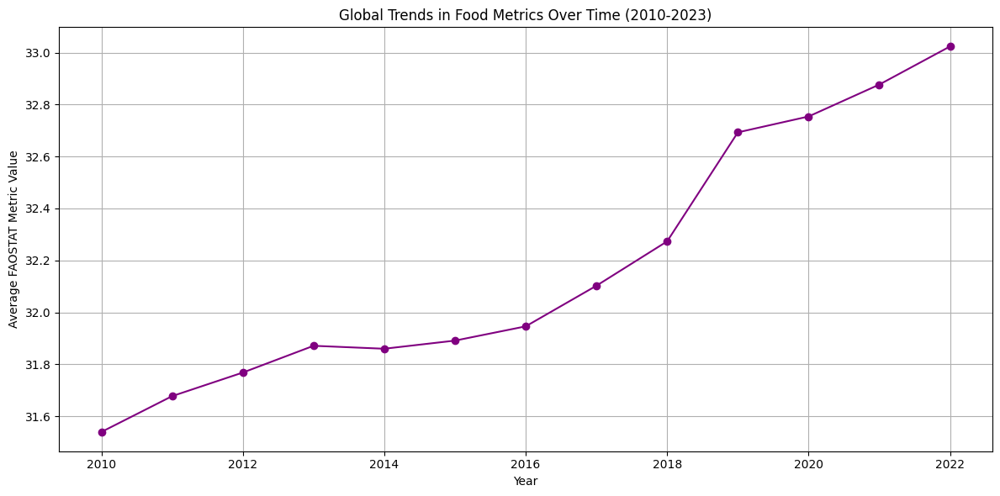

In [111]:
# Group by Year and calculate mean for food metrics
trend_data = df_filtered.groupby('Year')['FAOSTAT Metric Value'].mean()

# Line plot for food supply trends over time
plt.figure(figsize=(12, 6))
trend_data.plot(kind='line', marker='o', color='purple')
plt.title("Global Trends in Food Metrics Over Time (2010-2023)")
plt.ylabel("Average FAOSTAT Metric Value")
plt.xlabel("Year")
plt.grid()
plt.tight_layout()
plt.show()


**General Trends:**

An upward trend in food supply metrics (e.g., kcal/capita/day) over time would suggest that food security has improved globally from 2010 to 2023.
This improvement could reflect advances in agriculture, trade, and economic growth.

**Stability:**

Some metrics may show fluctuations (e.g., stock variation or losses), indicating challenges like climate change or trade disruptions.

## **3rd Data Set**
https://ourworldindata.org/co2-and-greenhouse-gas-emissions

In [112]:
# Define the GitHub raw file link
co2_file_url = "https://raw.githubusercontent.com/chetan-957/Data-Management-sp2025/refs/heads/main/annual-co-emissions.csv"

# Load the dataset directly from GitHub
df_co2 = pd.read_csv(co2_file_url)

# Display dataset info and first few rows
df_co2.info()
df_co2.head()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29137 entries, 0 to 29136
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Entity                29137 non-null  object 
 1   Year                  29137 non-null  int64  
 2   Annual CO₂ emissions  29137 non-null  float64
dtypes: float64(1), int64(1), object(1)
memory usage: 683.0+ KB


,Entity,Year,Annual CO₂ emissions
0,Afghanistan,1949,14656.0
1,Afghanistan,1950,84272.0
2,Afghanistan,1951,91600.0
3,Afghanistan,1952,91600.0
4,Afghanistan,1953,106256.0


In [113]:
import gdown

# Google Drive file ID
file_id = "1vTMWQuhNMBTC0Xx1XeEc3vs_ntcoLU1z"

# Destination file name
output = "annual-co-emissions.csv"  # Renaming the file

# Download the file
gdown.download(f"https://drive.google.com/uc?id={file_id}", output, quiet=False)

print("File downloaded and renamed to annual-co-emissions.csv!")


Downloading...
From: https://drive.google.com/uc?id=1vTMWQuhNMBTC0Xx1XeEc3vs_ntcoLU1z
To: /content/annual-co-emissions.csv
100%|██████████| 735k/735k [00:00<00:00, 32.9MB/s]

File downloaded and renamed to annual-co-emissions.csv!


In [114]:
# Define file path in Colab (update if needed)
file_path = "/content/annual-co-emissions.csv"

# Load dataset
df_co2 = pd.read_csv(file_path)

# Rename 'Entity' to 'Country' for consistency
df_co2.rename(columns={"Entity": "Country", "Annual CO₂ emissions": "Annual CO2 Emissions"}, inplace=True)

# Filter dataset to only include data from 2010 onwards
df_co2_filtered = df_co2[df_co2["Year"] >= 2010]

# Save cleaned dataset
df_co2_filtered.to_csv("/content/Cleaned_CO2_Emissions.csv", index=False)

# Display dataset information and first few rows
df_co2_filtered.info()
df_co2_filtered.head()


<class 'pandas.core.frame.DataFrame'>
Index: 3458 entries, 61 to 29136
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Country               3458 non-null   object 
 1   Year                  3458 non-null   int64  
 2   Annual CO2 Emissions  3458 non-null   float64
dtypes: float64(1), int64(1), object(1)
memory usage: 108.1+ KB


,Country,Year,Annual CO2 Emissions
61,Afghanistan,2010,8364803.5
62,Afghanistan,2011,11838316.0
63,Afghanistan,2012,10035314.0
64,Afghanistan,2013,9228517.0
65,Afghanistan,2014,9086037.0


### **MERGING WITH 3rd DATA SET**

In [115]:
# Load the FAOSTAT & WDI merged dataset
faostat_wdi_file = "/content/Cleaned_Improved_Merged_Data_2010_Onwards.csv"
df_faostat_wdi = pd.read_csv(faostat_wdi_file)

# Load the CO₂ dataset
co2_file = "/content/Cleaned_CO2_Emissions.csv"
df_co2 = pd.read_csv(co2_file)

# Merge datasets with an indicator column
df_final_merged = df_faostat_wdi.merge(df_co2, on=["Country", "Year"], how="outer", indicator=True)

# Rename the indicator column for clarity
df_final_merged.rename(columns={"_merge": "CO2_Match"}, inplace=True)

# Save the final merged dataset
final_file = "/content/Outer_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_final_merged.to_csv(final_file, index=False)

# Display dataset info and first few rows
df_final_merged.info()
df_final_merged.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 753983 entries, 0 to 753982
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   Country               753983 non-null  object  
 1   Food Category         752213 non-null  object  
 2   Metric                752213 non-null  object  
 3   Year                  753983 non-null  int64   
 4   FAOSTAT Metric Value  752213 non-null  float64 
 5   GDP per capita (US$)  752213 non-null  float64 
 6   GNI per capita (US$)  752213 non-null  float64 
 7   Gini Index            752213 non-null  float64 
 8   Trade (% of GDP)      752213 non-null  float64 
 9   Annual CO2 Emissions  709325 non-null  float64 
 10  CO2_Match             753983 non-null  category
dtypes: category(1), float64(6), int64(1), object(3)
memory usage: 58.2+ MB


,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,CO2_Match
0,Afghanistan,NaN,NaN,2010,NaN,NaN,NaN,NaN,NaN,8364803.5,right_only
1,Afghanistan,NaN,NaN,2011,NaN,NaN,NaN,NaN,NaN,11838316.0,right_only
2,Afghanistan,NaN,NaN,2012,NaN,NaN,NaN,NaN,NaN,10035314.0,right_only
3,Afghanistan,NaN,NaN,2013,NaN,NaN,NaN,NaN,NaN,9228517.0,right_only
4,Afghanistan,NaN,NaN,2014,NaN,NaN,NaN,NaN,NaN,9086037.0,right_only


1️⃣ how="outer"
Includes all rows from both datasets, even if no match exists.
If a country-year exists in one dataset but not the other, it still appears with NaN.

🚫 May add too many empty or irrelevant rows, making analysis harder.

In [116]:
# Load the FAOSTAT & WDI merged dataset
faostat_wdi_file = "/content/Cleaned_Improved_Merged_Data_2010_Onwards.csv"
df_faostat_wdi = pd.read_csv(faostat_wdi_file)

# Load the CO₂ dataset
co2_file = "/content/Cleaned_CO2_Emissions.csv"
df_co2 = pd.read_csv(co2_file)

# Merge datasets with an indicator column
df_final_merged = df_faostat_wdi.merge(df_co2, on=["Country", "Year"], how="inner", indicator=True)

# Rename the indicator column for clarity
df_final_merged.rename(columns={"_merge": "CO2_Match"}, inplace=True)

# Save the final merged dataset
final_file = "/content/Inner_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_final_merged.to_csv(final_file, index=False)

# Display dataset info and first few rows
df_final_merged.info()
df_final_merged.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 707555 entries, 0 to 707554
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   Country               707555 non-null  object  
 1   Food Category         707555 non-null  object  
 2   Metric                707555 non-null  object  
 3   Year                  707555 non-null  int64   
 4   FAOSTAT Metric Value  707555 non-null  float64 
 5   GDP per capita (US$)  707555 non-null  float64 
 6   GNI per capita (US$)  707555 non-null  float64 
 7   Gini Index            707555 non-null  float64 
 8   Trade (% of GDP)      707555 non-null  float64 
 9   Annual CO2 Emissions  707555 non-null  float64 
 10  CO2_Match             707555 non-null  category
dtypes: category(1), float64(6), int64(1), object(3)
memory usage: 54.7+ MB


,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,CO2_Match
0,Albania,Grand Total,Food supply (kcal/capita/day),2010,3256.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both
1,Albania,Grand Total,Protein supply quantity (g/capita/day),2010,109.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both
2,Albania,Grand Total,Fat supply quantity (g/capita/day),2010,105.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both
3,Albania,Vegetal Products,Food supply (kcal/capita/day),2010,2297.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both
4,Albania,Vegetal Products,Protein supply quantity (g/capita/day),2010,51.65,4094.349686,4360.0,32.8,76.54339,4783865.0,both


2️⃣ how="inner"
Keeps only matching rows where both FAOSTAT+WDI and CO₂ data exist.
Drops rows where CO₂ data is missing.

🚫 Not ideal because we'd lose important FAOSTAT & WDI data for years without CO₂ records.

In [117]:
# Load the FAOSTAT & WDI merged dataset
faostat_wdi_file = "/content/Cleaned_Improved_Merged_Data_2010_Onwards.csv"
df_faostat_wdi = pd.read_csv(faostat_wdi_file)

# Load the CO₂ dataset
co2_file = "/content/Cleaned_CO2_Emissions.csv"
df_co2 = pd.read_csv(co2_file)

# Merge datasets with an indicator column
df_final_merged = df_faostat_wdi.merge(df_co2, on=["Country", "Year"], how="left", indicator=True)

# Rename the indicator column for clarity
df_final_merged.rename(columns={"_merge": "CO2_Match"}, inplace=True)

# Save the final merged dataset
final_file = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_final_merged.to_csv(final_file, index=False)

# Display dataset info and first few rows
df_final_merged.info()
df_final_merged.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 752213 entries, 0 to 752212
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   Country               752213 non-null  object  
 1   Food Category         752213 non-null  object  
 2   Metric                752213 non-null  object  
 3   Year                  752213 non-null  int64   
 4   FAOSTAT Metric Value  752213 non-null  float64 
 5   GDP per capita (US$)  752213 non-null  float64 
 6   GNI per capita (US$)  752213 non-null  float64 
 7   Gini Index            752213 non-null  float64 
 8   Trade (% of GDP)      752213 non-null  float64 
 9   Annual CO2 Emissions  707555 non-null  float64 
 10  CO2_Match             752213 non-null  category
dtypes: category(1), float64(6), int64(1), object(3)
memory usage: 58.1+ MB


,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,CO2_Match
0,Albania,Grand Total,Food supply (kcal/capita/day),2010,3256.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both
1,Albania,Grand Total,Protein supply quantity (g/capita/day),2010,109.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both
2,Albania,Grand Total,Fat supply quantity (g/capita/day),2010,105.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both
3,Albania,Vegetal Products,Food supply (kcal/capita/day),2010,2297.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both
4,Albania,Vegetal Products,Protein supply quantity (g/capita/day),2010,51.65,4094.349686,4360.0,32.8,76.54339,4783865.0,both


3️⃣ how="left" (Used in Your Case)
Keeps all rows from the FAOSTAT & WDI dataset.
Adds CO₂ data where available; if missing, it stays as NaN.
Does not remove any FAOSTAT & WDI data.

✅ Best when FAOSTAT & WDI data is primary, and CO₂ data is secondary.

➡️ This ensures food security & economic data remains intact, even if CO₂ data is missing.

In [118]:
# Load the FAOSTAT & WDI merged dataset
faostat_wdi_file = "/content/Cleaned_Improved_Merged_Data_2010_Onwards.csv"
df_faostat_wdi = pd.read_csv(faostat_wdi_file)

# Load the CO₂ dataset
co2_file = "/content/Cleaned_CO2_Emissions.csv"
df_co2 = pd.read_csv(co2_file)

# Merge datasets with an indicator column
df_final_merged = df_faostat_wdi.merge(df_co2, on=["Country", "Year"], how="right", indicator=True)

# Rename the indicator column for clarity
df_final_merged.rename(columns={"_merge": "CO2_Match"}, inplace=True)

# Save the final merged dataset
final_file = "/content/Right_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_final_merged.to_csv(final_file, index=False)

# Display dataset info and first few rows
df_final_merged.info()
df_final_merged.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 709325 entries, 0 to 709324
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   Country               709325 non-null  object  
 1   Food Category         707555 non-null  object  
 2   Metric                707555 non-null  object  
 3   Year                  709325 non-null  int64   
 4   FAOSTAT Metric Value  707555 non-null  float64 
 5   GDP per capita (US$)  707555 non-null  float64 
 6   GNI per capita (US$)  707555 non-null  float64 
 7   Gini Index            707555 non-null  float64 
 8   Trade (% of GDP)      707555 non-null  float64 
 9   Annual CO2 Emissions  709325 non-null  float64 
 10  CO2_Match             709325 non-null  category
dtypes: category(1), float64(6), int64(1), object(3)
memory usage: 54.8+ MB


,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,CO2_Match
0,Afghanistan,NaN,NaN,2010,NaN,NaN,NaN,NaN,NaN,8364803.5,right_only
1,Afghanistan,NaN,NaN,2011,NaN,NaN,NaN,NaN,NaN,11838316.0,right_only
2,Afghanistan,NaN,NaN,2012,NaN,NaN,NaN,NaN,NaN,10035314.0,right_only
3,Afghanistan,NaN,NaN,2013,NaN,NaN,NaN,NaN,NaN,9228517.0,right_only
4,Afghanistan,NaN,NaN,2014,NaN,NaN,NaN,NaN,NaN,9086037.0,right_only


4️⃣ how="right"
Keeps all rows from the CO₂ dataset, and only matching FAOSTAT+WDI rows.
Drops FAOSTAT+WDI rows that have no CO₂ data.

🚫 Not useful because FAOSTAT & WDI are our main datasets, not CO₂.

In [119]:
# Load the merged dataset with CO₂ indicator column
merged_file_path = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_merged = pd.read_csv(merged_file_path)

# Count the number of rows where CO₂ data is missing
missing_co2_count = df_merged[df_merged["CO2_Match"] == "left_only"].shape[0]

# Display the result
print(f"Number of rows missing CO₂ data: {missing_co2_count}")


Number of rows missing CO₂ data: 44658


In [120]:
# Display the first 10 rows of the merged dataset
df_merged.head(10)


,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,CO2_Match
0,Albania,Grand Total,Food supply (kcal/capita/day),2010,3256.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both
1,Albania,Grand Total,Protein supply quantity (g/capita/day),2010,109.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both
2,Albania,Grand Total,Fat supply quantity (g/capita/day),2010,105.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both
3,Albania,Vegetal Products,Food supply (kcal/capita/day),2010,2297.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both
4,Albania,Vegetal Products,Protein supply quantity (g/capita/day),2010,51.65,4094.349686,4360.0,32.8,76.54339,4783865.0,both
5,Albania,Vegetal Products,Fat supply quantity (g/capita/day),2010,41.49,4094.349686,4360.0,32.8,76.54339,4783865.0,both
6,Albania,Animal Products,Food supply (kcal/capita/day),2010,959.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both
7,Albania,Animal Products,Protein supply quantity (g/capita/day),2010,57.42,4094.349686,4360.0,32.8,76.54339,4783865.0,both
8,Albania,Animal Products,Fat supply quantity (g/capita/day),2010,63.58,4094.349686,4360.0,32.8,76.54339,4783865.0,both
9,Albania,Cereals - Excluding Beer,Food supply quantity (kg/capita/yr),2010,163.78,4094.349686,4360.0,32.8,76.54339,4783865.0,both


In [121]:
# Load the merged dataset
file_path = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_merged = pd.read_csv(file_path)

# Find country names where CO₂ data is missing
missing_countries = df_merged[df_merged["CO2_Match"] == "left_only"]["Country"].unique()

# Print the countries
print("Countries missing CO₂ data:", missing_countries)


Countries missing CO₂ data: ['Cabo Verde' 'Congo, Dem. Rep.' 'Congo, Rep.' 'Korea, Rep.'
 'Russian Federation' 'Syrian Arab Republic' 'Timor-Leste' 'Viet Nam']


In [122]:
import pandas as pd

# Load the merged dataset
merged_file_path = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_merged = pd.read_csv(merged_file_path)

# Standardize country names
country_name_mapping = {
    "Cabo Verde": "Cape Verde",
    "Congo, Dem. Rep.": "Democratic Republic of the Congo",
    "Congo, Rep.": "Republic of the Congo",
    "Korea, Rep.": "South Korea",
    "Russian Federation": "Russia",
    "Syrian Arab Republic": "Syria",
    "Timor-Leste": "East Timor",
    "Viet Nam": "Vietnam"
}

# Apply the country name corrections
df_merged["Country"] = df_merged["Country"].replace(country_name_mapping)

# Display the first few rows after standardization
df_merged.head()


,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,CO2_Match
0,Albania,Grand Total,Food supply (kcal/capita/day),2010,3256.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both
1,Albania,Grand Total,Protein supply quantity (g/capita/day),2010,109.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both
2,Albania,Grand Total,Fat supply quantity (g/capita/day),2010,105.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both
3,Albania,Vegetal Products,Food supply (kcal/capita/day),2010,2297.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both
4,Albania,Vegetal Products,Protein supply quantity (g/capita/day),2010,51.65,4094.349686,4360.0,32.8,76.54339,4783865.0,both


In [123]:
# Re-check missing CO₂ data after standardizing country names
missing_co2_count_after_fix = df_merged[df_merged["CO2_Match"] == "left_only"].shape[0]

# Display the result
print(f"Number of rows still missing CO₂ data after standardization: {missing_co2_count_after_fix}")


Number of rows still missing CO₂ data after standardization: 44658


In [124]:
import pandas as pd

# Load the merged dataset
merged_file_path = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_merged = pd.read_csv(merged_file_path)

# Filter rows where CO₂ data exists but FAOSTAT/WDI data is missing
missing_years = df_merged[df_merged["CO2_Match"] == "right_only"]["Year"].unique()

# Print the unique years that exist only in CO₂ data
print("Years with CO₂ data but missing FAOSTAT/WDI data:", missing_years)


Years with CO₂ data but missing FAOSTAT/WDI data: []


In [125]:
import pandas as pd

# Load the merged dataset
merged_file_path = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_merged = pd.read_csv(merged_file_path)

# Filter rows where CO₂ data exists but FAOSTAT/WDI data is missing
missing_countries = df_merged[df_merged["CO2_Match"] == "right_only"]["Country"].unique()

# Print the unique countries that exist only in CO₂ data
print("Countries with CO₂ data but missing FAOSTAT/WDI data:", missing_countries)


Countries with CO₂ data but missing FAOSTAT/WDI data: []


In [126]:
# Count the number of rows where CO₂ data exists but FAOSTAT/WDI data is missing
right_only_count = df_merged[df_merged["CO2_Match"] == "right_only"].shape[0]

# Display the result
print(f"Total number of 'right_only' rows: {right_only_count}")


Total number of 'right_only' rows: 0


In [127]:
# Filter country-year pairs where CO₂ data exists but FAOSTAT/WDI data is missing
right_only_pairs = df_merged[df_merged["CO2_Match"] == "right_only"][["Country", "Year"]]

# Display the first few rows
print("Country-Year pairs with CO₂ data but missing FAOSTAT/WDI data:")
right_only_pairs.head(10)


Country-Year pairs with CO₂ data but missing FAOSTAT/WDI data:


,Country,Year


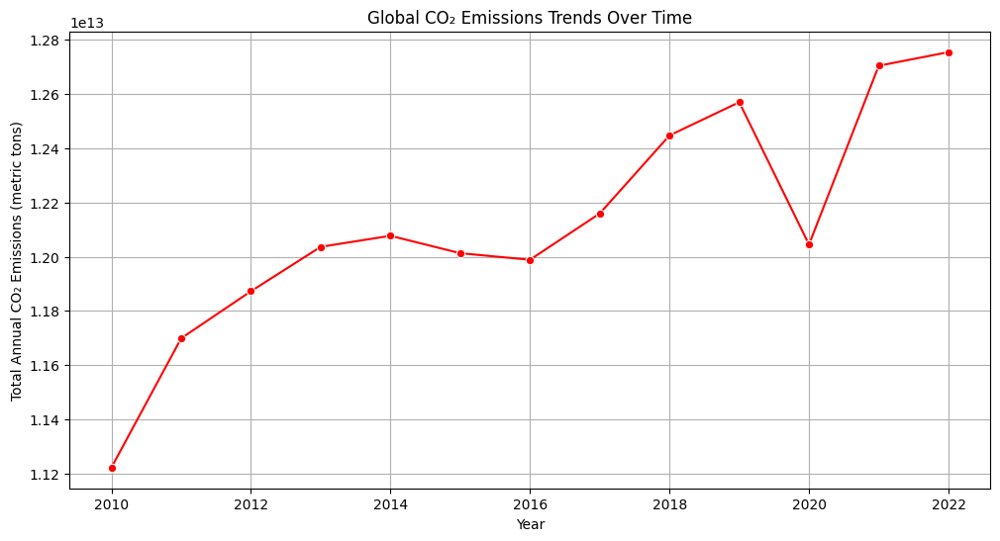

In [128]:
import matplotlib.pyplot as plt
import seaborn as sns

# Group CO₂ data by year to analyze global trends
co2_trend = df_merged.groupby("Year")["Annual CO2 Emissions"].sum()

# Plot CO₂ emissions over time
plt.figure(figsize=(12,6))
sns.lineplot(x=co2_trend.index, y=co2_trend.values, marker="o", color="red")
plt.title("Global CO₂ Emissions Trends Over Time")
plt.xlabel("Year")
plt.ylabel("Total Annual CO₂ Emissions (metric tons)")
plt.grid(True)
plt.show()


#### **📌 1. Map/Recode (Transform Column Values)**

**Example 1:** Recode Income Groups Based on GDP per Capita

This maps countries into income categories based on their GDP per capita:

In [129]:
# Define GDP per capita categories
def gdp_category(gdp):
    if gdp < 1000:
        return "Low Income"
    elif 1000 <= gdp < 4000:
        return "Lower Middle Income"
    elif 4000 <= gdp < 12000:
        return "Upper Middle Income"
    else:
        return "High Income"

# Apply the mapping to create a new column
df_merged["Income Group"] = df_merged["GDP per capita (US$)"].map(gdp_category)

# Display sample results
df_merged[["Country", "GDP per capita (US$)", "Income Group"]].head(10)


,Country,GDP per capita (US$),Income Group
0,Albania,4094.349686,Upper Middle Income
1,Albania,4094.349686,Upper Middle Income
2,Albania,4094.349686,Upper Middle Income
3,Albania,4094.349686,Upper Middle Income
4,Albania,4094.349686,Upper Middle Income
5,Albania,4094.349686,Upper Middle Income
6,Albania,4094.349686,Upper Middle Income
7,Albania,4094.349686,Upper Middle Income
8,Albania,4094.349686,Upper Middle Income
9,Albania,4094.349686,Upper Middle Income


**Example 2:** Recode Food Categories

This relabels food categories into broader groups:

In [130]:
# Mapping specific food items to broader categories
food_category_mapping = {
    "Cereals - Excluding Beer": "Staples",
    "Wheat and products": "Staples",
    "Rice and products": "Staples",
    "Milk - Excluding Butter": "Dairy",
    "Meat": "Animal Products",
    "Fish and seafood": "Animal Products",
}

# Apply the mapping
df_merged["Food Group"] = df_merged["Food Category"].map(food_category_mapping).fillna("Other")

# Display sample results
df_merged[["Food Category", "Food Group"]].drop_duplicates().head(10)


,Food Category,Food Group
0,Grand Total,Other
3,Vegetal Products,Other
6,Animal Products,Other
9,Cereals - Excluding Beer,Staples
13,Wheat and products,Staples
17,Rice and products,Staples
21,Barley and products,Other
25,Maize and products,Other
29,Rye and products,Other
33,Oats,Other


#### **📌 2. Replace on Condition**

**Example 1:** Replace High CO₂ Emitters with 'Very High Emissions'

This flags extremely high CO₂ emissions for better classification:

In [131]:
# Replace based on condition
df_merged.loc[df_merged["Annual CO2 Emissions"] > 1e9, "CO2 Emission Level"] = "Very High Emissions"

# Display sample results
df_merged[["Country", "Annual CO2 Emissions", "CO2 Emission Level"]].dropna().head(10)


,Country,Annual CO2 Emissions,CO2 Emission Level
135166,China,8.620576e+09,Very High Emissions
135167,China,8.620576e+09,Very High Emissions
135168,China,8.620576e+09,Very High Emissions
135169,China,8.620576e+09,Very High Emissions
135170,China,8.620576e+09,Very High Emissions
135171,China,8.620576e+09,Very High Emissions
135172,China,8.620576e+09,Very High Emissions
135173,China,8.620576e+09,Very High Emissions
135174,China,8.620576e+09,Very High Emissions
135175,China,8.620576e+09,Very High Emissions


**Example 2:** Replace Missing Gini Index with Country Median

This helps fill missing Gini Index values intelligently:

In [132]:
# Replace missing Gini Index values with country median
df_merged["Gini Index"] = df_merged.groupby("Country")["Gini Index"].transform(lambda x: x.fillna(x.median()))

# Display sample results
df_merged[["Country", "Gini Index"]].tail(10)


,Country,Gini Index
752203,Zimbabwe,44.3
752204,Zimbabwe,44.3
752205,Zimbabwe,44.3
752206,Zimbabwe,44.3
752207,Zimbabwe,44.3
752208,Zimbabwe,44.3
752209,Zimbabwe,44.3
752210,Zimbabwe,44.3
752211,Zimbabwe,44.3
752212,Zimbabwe,44.3


#### **📌 3. Subset/Slice (Extract Relevant Data)**
**Example 1:** Subset High-Income Countries Only

This extracts data only for high-income countries:

In [133]:
# Subset only high-income countries
df_high_income = df_merged[df_merged["Income Group"] == "High Income"]

# Display dataset info
df_high_income.info()


<class 'pandas.core.frame.DataFrame'>
Index: 215155 entries, 16273 to 724666
Data columns (total 14 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Country               215155 non-null  object 
 1   Food Category         215155 non-null  object 
 2   Metric                215155 non-null  object 
 3   Year                  215155 non-null  int64  
 4   FAOSTAT Metric Value  215155 non-null  float64
 5   GDP per capita (US$)  215155 non-null  float64
 6   GNI per capita (US$)  215155 non-null  float64
 7   Gini Index            215155 non-null  float64
 8   Trade (% of GDP)      215155 non-null  float64
 9   Annual CO2 Emissions  206967 non-null  float64
 10  CO2_Match             215155 non-null  object 
 11  Income Group          215155 non-null  object 
 12  Food Group            215155 non-null  object 
 13  CO2 Emission Level    11856 non-null   object 
dtypes: float64(6), int64(1), object(7)
memory usage: 24.6

**Example 2:** Extract Data for a Specific Country (India)

This retrieves data for India for focused analysis:

In [134]:
# Subset data for India
df_india = df_merged[df_merged["Country"] == "India"]

# Display first few rows
df_india.head()


,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,CO2_Match,Income Group,Food Group,CO2 Emission Level
303556,India,Grand Total,Food supply (kcal/capita/day),2010,2363.00,1347.519391,1210.0,34.6,49.255206,1.677337e+09,both,Lower Middle Income,Other,Very High Emissions
303557,India,Grand Total,Protein supply quantity (g/capita/day),2010,60.52,1347.519391,1210.0,34.6,49.255206,1.677337e+09,both,Lower Middle Income,Other,Very High Emissions
303558,India,Grand Total,Fat supply quantity (g/capita/day),2010,48.99,1347.519391,1210.0,34.6,49.255206,1.677337e+09,both,Lower Middle Income,Other,Very High Emissions
303559,India,Vegetal Products,Food supply (kcal/capita/day),2010,2136.00,1347.519391,1210.0,34.6,49.255206,1.677337e+09,both,Lower Middle Income,Other,Very High Emissions
303560,India,Vegetal Products,Protein supply quantity (g/capita/day),2010,48.99,1347.519391,1210.0,34.6,49.255206,1.677337e+09,both,Lower Middle Income,Other,Very High Emissions


#### **📌 4. GroupBy/Aggregate**
**Example 1:** Average CO₂ Emissions by Income Group

This computes average CO₂ emissions for each income group:

In [135]:
# Group by income group and calculate average CO2 emissions
co2_by_income = df_merged.groupby("Income Group")["Annual CO2 Emissions"].mean().reset_index()

# Display results
co2_by_income


,Income Group,Annual CO2 Emissions
0,High Income,3.382253e+08
1,Low Income,5.760027e+06
2,Lower Middle Income,1.034984e+08
3,Upper Middle Income,3.187086e+08


**Example 2:** Total Food Supply by Year

This aggregates total food supply per year:

In [136]:
# Group by year and sum food supply
food_trends = df_merged.groupby("Year")["FAOSTAT Metric Value"].sum().reset_index()

# Display results
food_trends.head()


,Year,FAOSTAT Metric Value
0,2010,1833083.245
1,2011,1842484.630
2,2012,1846619.455
3,2013,1852098.505
4,2014,1855684.095


### **Visualizations**

#### **1️⃣Perform country-level CO₂ analysis**

Example: Compare CO₂ trends for different countries (e.g., high-income vs. low-income nations).

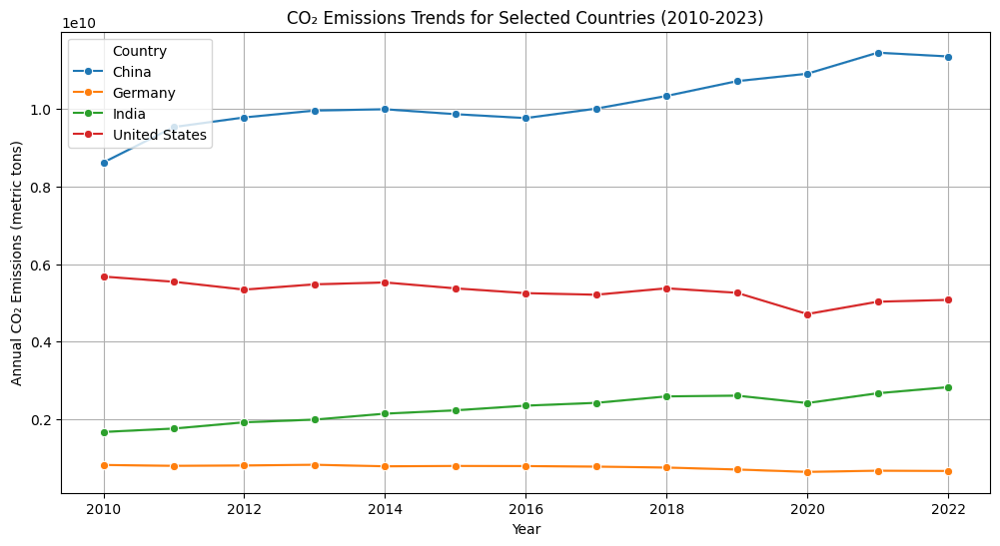

In [137]:
# Load the merged dataset
file_path = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_merged = pd.read_csv(file_path)

# Select countries for comparison (High vs. Low income)
selected_countries = ["United States", "China", "India", "Germany", "Nigeria"]

# Filter the dataset for selected countries
df_selected = df_merged[df_merged["Country"].isin(selected_countries)]

# Plot CO₂ emissions trends for selected countries
plt.figure(figsize=(12,6))
sns.lineplot(data=df_selected, x="Year", y="Annual CO2 Emissions", hue="Country", marker="o")

# Customize the plot
plt.title("CO₂ Emissions Trends for Selected Countries (2010-2023)")
plt.xlabel("Year")
plt.ylabel("Annual CO₂ Emissions (metric tons)")
plt.legend(title="Country")
plt.grid(True)
plt.show()


1. Selected a set of countries to compare.

Example: United States, China, India, Germany, Nigeria (Diverse income levels).
2. Filtered CO₂ emissions data for these countries.

3. Visualized CO₂ Trends Over Time

Compared emissions patterns for high-income vs. low-income countries

In [138]:
co2_by_country=df_merged.groupby('Country')['Annual CO2 Emissions'].sum().reset_index()
selected_countries = ["United States", "China", "India", "Germany"]
co2_by_country = co2_by_country[co2_by_country["Country"].isin(selected_countries)]

print(co2_by_country.head(2))

    Country  Annual CO2 Emissions
25    China          6.017940e+13
46  Germany          3.958693e+12


#### **2️⃣ CO₂ Emissions Pie Chart (2010-2023)**

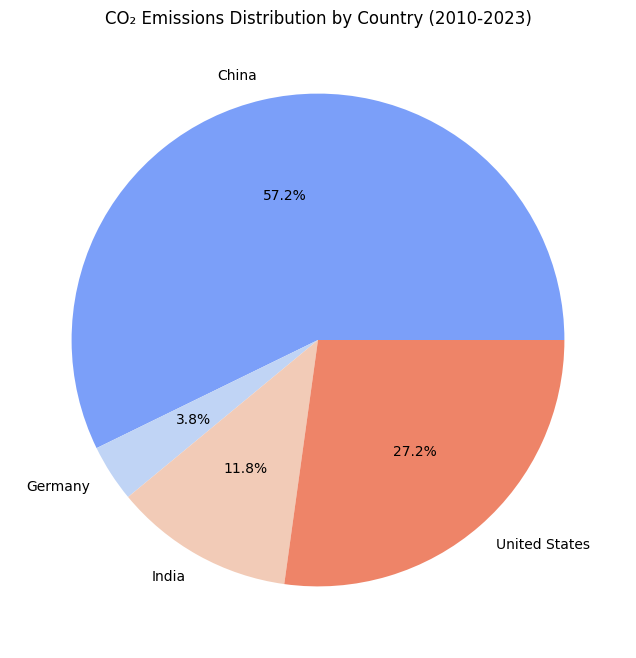

In [139]:
# Create a pie chart for CO₂ emissions distribution
plt.figure(figsize=(8,8))
plt.pie(co2_by_country["Annual CO2 Emissions"], labels=co2_by_country["Country"], autopct='%1.1f%%', colors=sns.color_palette("coolwarm", len(selected_countries)))

# Customize the plot
plt.title("CO₂ Emissions Distribution by Country (2010-2023)")
plt.show()

1️⃣ China is the largest CO₂ emitter

China contributes 57.2% of the total CO₂ emissions among the selected countries.
This aligns with China’s rapid industrial growth and heavy reliance on coal energy.

2️⃣ The United States is the second-largest emitter

The US accounts for 27.2% of the total CO₂ emissions.
Despite having a smaller population than China or India, higher per capita emissions contribute to this.

3️⃣ India contributes 11.8%

India’s emissions are significantly lower than China’s, but growing due to industrialization.
However, India still emits less than the US despite having a larger population.

4️⃣ Germany’s contribution is minimal (3.8%)

Germany has lower emissions due to strong climate policies and a shift to renewable energy.
It is significantly lower than China and the US, despite being a high-income country.


📌 **Key Insights**

✅ China & the US dominate CO₂ emissions, together making up over 84% of emissions in this sample.

✅ Developing countries (India, Nigeria) contribute less, but their emissions may grow as they industrialize.

✅ Germany stands out as a low-emission developed country, showing the impact of climate policies.

Correlation between CO₂ emissions and economic/food security indicators:

                      Annual CO2 Emissions  GDP per capita (US$)  \
Annual CO2 Emissions              1.000000              0.087408   
GDP per capita (US$)              0.087408              1.000000   
Trade (% of GDP)                 -0.156493              0.357969   
FAOSTAT Metric Value              0.003517              0.019411   

                      Trade (% of GDP)  FAOSTAT Metric Value  
Annual CO2 Emissions         -0.156493              0.003517  
GDP per capita (US$)          0.357969              0.019411  
Trade (% of GDP)              1.000000              0.009357  
FAOSTAT Metric Value          0.009357              1.000000  


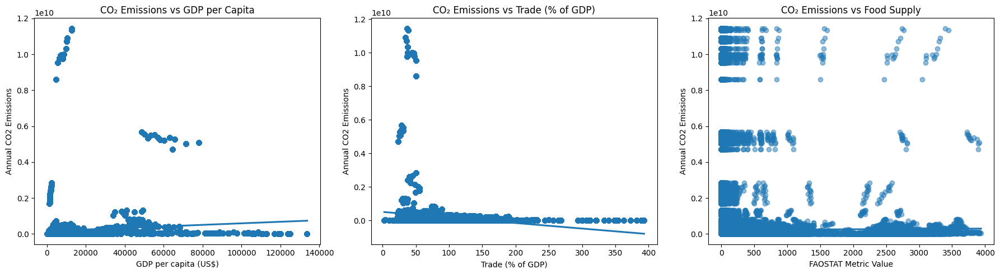

In [140]:
# Load the merged dataset
file_path = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_merged = pd.read_csv(file_path)

# Select relevant columns for analysis
columns_to_analyze = [
    "Annual CO2 Emissions",
    "GDP per capita (US$)",
    "Trade (% of GDP)",
    "FAOSTAT Metric Value"
]

# Drop missing values to avoid errors in correlation
df_analysis = df_merged[columns_to_analyze].dropna()

# Compute correlation matrix
correlation_matrix = df_analysis.corr()

# Display correlation results
print("Correlation between CO₂ emissions and economic/food security indicators:\n")
print(correlation_matrix)

# 📊 Scatter Plots to Visualize Relationships
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# CO₂ vs GDP per capita
sns.regplot(data=df_analysis, x="GDP per capita (US$)", y="Annual CO2 Emissions", ax=axes[0], scatter_kws={"alpha":0.5})
axes[0].set_title("CO₂ Emissions vs GDP per Capita")

# CO₂ vs Trade (% of GDP)
sns.regplot(data=df_analysis, x="Trade (% of GDP)", y="Annual CO2 Emissions", ax=axes[1], scatter_kws={"alpha":0.5})
axes[1].set_title("CO₂ Emissions vs Trade (% of GDP)")

# CO₂ vs Food Supply
sns.regplot(data=df_analysis, x="FAOSTAT Metric Value", y="Annual CO2 Emissions", ax=axes[2], scatter_kws={"alpha":0.5})
axes[2].set_title("CO₂ Emissions vs Food Supply")

plt.tight_layout()
plt.show()


### **4th Data Set**

In [141]:
import gdown
import pandas as pd

# Google Drive file ID
file_id = "1LOJK3aOGfKKXWf--jrJyBe7wxR132X6e"

# Construct the direct download URL
download_url = f"https://drive.google.com/uc?id={file_id}"

# Define the output file name
output_file = "/content/methane_emissions_data.csv"

# Download the file
gdown.download(download_url, output_file, quiet=False)

# Load the dataset (since it's a CSV file)
df_methane = pd.read_csv(output_file)

# Display dataset info and first few rows
df_methane.info()
df_methane.head()


Downloading...
From: https://drive.google.com/uc?id=1LOJK3aOGfKKXWf--jrJyBe7wxR132X6e
To: /content/methane_emissions_data.csv
100%|██████████| 1.11M/1.11M [00:00<00:00, 41.1MB/s]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37410 entries, 0 to 37409
Data columns (total 4 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Entity                     37410 non-null  object 
 1   Code                       34278 non-null  object 
 2   Year                       37410 non-null  int64  
 3   Annual methane emissions   37410 non-null  float64
dtypes: float64(1), int64(1), object(2)
memory usage: 1.1+ MB


,Entity,Code,Year,Annual methane emissions
0,Afghanistan,AFG,1850,3594926.2
1,Afghanistan,AFG,1851,3615134.2
2,Afghanistan,AFG,1852,3635346.8
3,Afghanistan,AFG,1853,3655563.5
4,Afghanistan,AFG,1854,3675785.0


In [142]:
import pandas as pd

# Load FAOSTAT + WDI + CO₂ dataset
file_path = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_base = pd.read_csv(file_path)

# Print unique country names
unique_countries = df_base["Country"].unique()

# Display country names
print("Unique Country Names in FAOSTAT + WDI + CO₂ Dataset:\n", unique_countries)


Unique Country Names in FAOSTAT + WDI + CO₂ Dataset:
 ['Albania' 'Algeria' 'Angola' 'Argentina' 'Armenia' 'Australia' 'Austria'
 'Bangladesh' 'Belarus' 'Belgium' 'Benin' 'Bhutan' 'Bolivia'
 'Bosnia and Herzegovina' 'Botswana' 'Brazil' 'Bulgaria' 'Burkina Faso'
 'Burundi' 'Cabo Verde' 'Cameroon' 'Canada' 'Central African Republic'
 'Chad' 'Chile' 'China' 'Colombia' 'Comoros' 'Congo, Dem. Rep.'
 'Congo, Rep.' 'Costa Rica' 'Croatia' 'Cyprus' 'Czechia' 'Denmark'
 'Djibouti' 'Dominican Republic' 'Ecuador' 'El Salvador' 'Estonia'
 'Ethiopia' 'Fiji' 'Finland' 'France' 'Gabon' 'Georgia' 'Germany' 'Ghana'
 'Greece' 'Guatemala' 'Guinea' 'Guinea-Bissau' 'Haiti' 'Honduras'
 'Hungary' 'Iceland' 'India' 'Indonesia' 'Iraq' 'Ireland' 'Israel' 'Italy'
 'Jamaica' 'Japan' 'Jordan' 'Kazakhstan' 'Kenya' 'Kiribati' 'Korea, Rep.'
 'Latvia' 'Lebanon' 'Lesotho' 'Lithuania' 'Luxembourg' 'Madagascar'
 'Malaysia' 'Maldives' 'Mali' 'Malta' 'Marshall Islands' 'Mauritania'
 'Mauritius' 'Mexico' 'Mongolia' 'Montenegr

In [143]:
import pandas as pd

# Load the FAOSTAT + WDI + CO₂ dataset
file_path = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_base = pd.read_csv(file_path)

# Define country name mapping for simplification
country_name_mapping = {
    "Cabo Verde": "Cape Verde",
    "Congo, Dem. Rep.": "Democratic Republic of the Congo",
    "Congo, Rep.": "Republic of the Congo",
    "Korea, Rep.": "South Korea",
    "Russian Federation": "Russia",
    "Syrian Arab Republic": "Syria",
    "Timor-Leste": "East Timor",
    "Viet Nam": "Vietnam",
    "United States": "USA",
    "United Arab Emirates": "UAE",
    "North Macedonia": "Macedonia"
}

# Apply the country name corrections
df_base["Country"] = df_base["Country"].replace(country_name_mapping)

# Display the updated country names
unique_countries_updated = df_base["Country"].unique()
print("Updated Country Names:\n", unique_countries_updated)


Updated Country Names:
 ['Albania' 'Algeria' 'Angola' 'Argentina' 'Armenia' 'Australia' 'Austria'
 'Bangladesh' 'Belarus' 'Belgium' 'Benin' 'Bhutan' 'Bolivia'
 'Bosnia and Herzegovina' 'Botswana' 'Brazil' 'Bulgaria' 'Burkina Faso'
 'Burundi' 'Cape Verde' 'Cameroon' 'Canada' 'Central African Republic'
 'Chad' 'Chile' 'China' 'Colombia' 'Comoros'
 'Democratic Republic of the Congo' 'Republic of the Congo' 'Costa Rica'
 'Croatia' 'Cyprus' 'Czechia' 'Denmark' 'Djibouti' 'Dominican Republic'
 'Ecuador' 'El Salvador' 'Estonia' 'Ethiopia' 'Fiji' 'Finland' 'France'
 'Gabon' 'Georgia' 'Germany' 'Ghana' 'Greece' 'Guatemala' 'Guinea'
 'Guinea-Bissau' 'Haiti' 'Honduras' 'Hungary' 'Iceland' 'India'
 'Indonesia' 'Iraq' 'Ireland' 'Israel' 'Italy' 'Jamaica' 'Japan' 'Jordan'
 'Kazakhstan' 'Kenya' 'Kiribati' 'South Korea' 'Latvia' 'Lebanon'
 'Lesotho' 'Lithuania' 'Luxembourg' 'Madagascar' 'Malaysia' 'Maldives'
 'Mali' 'Malta' 'Marshall Islands' 'Mauritania' 'Mauritius' 'Mexico'
 'Mongolia' 'Montenegro' 

In [144]:
import pandas as pd

# Load Methane dataset
file_path = "/content/methane_emissions_data.csv"
df_methane = pd.read_csv(file_path)

# Print unique country names
unique_countries_methane = df_methane["Entity"].unique()

# Display country names
print("Unique Country Names in Methane Dataset:\n", unique_countries_methane)


Unique Country Names in Methane Dataset:
 ['Afghanistan' 'Africa' 'Albania' 'Algeria' 'Andorra' 'Angola'
 'Antigua and Barbuda' 'Argentina' 'Armenia' 'Asia'
 'Asia (excl. China and India)' 'Australia' 'Austria' 'Azerbaijan'
 'Bahamas' 'Bahrain' 'Bangladesh' 'Barbados' 'Belarus' 'Belgium' 'Belize'
 'Benin' 'Bhutan' 'Bolivia' 'Bosnia and Herzegovina' 'Botswana' 'Brazil'
 'Brunei' 'Bulgaria' 'Burkina Faso' 'Burundi' 'Cambodia' 'Cameroon'
 'Canada' 'Cape Verde' 'Central African Republic' 'Chad' 'Chile' 'China'
 'Colombia' 'Comoros' 'Congo' 'Cook Islands' 'Costa Rica' "Cote d'Ivoire"
 'Croatia' 'Cuba' 'Cyprus' 'Czechia' 'Democratic Republic of Congo'
 'Denmark' 'Djibouti' 'Dominica' 'Dominican Republic' 'East Timor'
 'Ecuador' 'Egypt' 'El Salvador' 'Equatorial Guinea' 'Eritrea' 'Estonia'
 'Eswatini' 'Ethiopia' 'Europe' 'Europe (excl. EU-27)'
 'Europe (excl. EU-28)' 'European Union (27)' 'European Union (28)' 'Fiji'
 'Finland' 'France' 'Gabon' 'Gambia' 'Georgia' 'Germany' 'Ghana' 'Greece'
 '

In [145]:
import pandas as pd

# Load the Methane dataset
file_path = "/content/methane_emissions_data.csv"
df_methane = pd.read_csv(file_path)

# Define country name mapping for Methane dataset to match FAOSTAT + WDI + CO₂
methane_country_mapping = {
    "Cote d'Ivoire": "Ivory Coast",
    "Democratic Republic of Congo": "Democratic Republic of the Congo",
    "Congo": "Republic of the Congo",
    "United States of America": "USA",
    "United Kingdom": "United Kingdom",
    "Russian Federation": "Russia",
    "Syrian Arab Republic": "Syria",
    "Iran": "Iran",
    "Viet Nam": "Vietnam",
    "Republic of Korea": "South Korea",
    "North Macedonia": "Macedonia",
    "United Arab Emirates": "UAE",
    "Eswatini": "Swaziland",
    "Laos": "Lao People's Democratic Republic",
    "Gambia": "The Gambia",
    "Bolivia": "Bolivia",
    "Myanmar": "Burma"
}

# Apply the country name corrections to the Methane dataset
df_methane["Entity"] = df_methane["Entity"].replace(methane_country_mapping)

# Display the updated country names from the Methane dataset
unique_countries_methane_updated = df_methane["Entity"].unique()
print("Updated Country Names in Methane Dataset:\n", unique_countries_methane_updated)


Updated Country Names in Methane Dataset:
 ['Afghanistan' 'Africa' 'Albania' 'Algeria' 'Andorra' 'Angola'
 'Antigua and Barbuda' 'Argentina' 'Armenia' 'Asia'
 'Asia (excl. China and India)' 'Australia' 'Austria' 'Azerbaijan'
 'Bahamas' 'Bahrain' 'Bangladesh' 'Barbados' 'Belarus' 'Belgium' 'Belize'
 'Benin' 'Bhutan' 'Bolivia' 'Bosnia and Herzegovina' 'Botswana' 'Brazil'
 'Brunei' 'Bulgaria' 'Burkina Faso' 'Burundi' 'Cambodia' 'Cameroon'
 'Canada' 'Cape Verde' 'Central African Republic' 'Chad' 'Chile' 'China'
 'Colombia' 'Comoros' 'Republic of the Congo' 'Cook Islands' 'Costa Rica'
 'Ivory Coast' 'Croatia' 'Cuba' 'Cyprus' 'Czechia'
 'Democratic Republic of the Congo' 'Denmark' 'Djibouti' 'Dominica'
 'Dominican Republic' 'East Timor' 'Ecuador' 'Egypt' 'El Salvador'
 'Equatorial Guinea' 'Eritrea' 'Estonia' 'Swaziland' 'Ethiopia' 'Europe'
 'Europe (excl. EU-27)' 'Europe (excl. EU-28)' 'European Union (27)'
 'European Union (28)' 'Fiji' 'Finland' 'France' 'Gabon' 'The Gambia'
 'Georgia' 'Ger

In [146]:
# Display available columns in the Methane dataset
print("Columns in Methane dataset:", df_methane.columns)


Columns in Methane dataset: Index(['Entity', 'Code', 'Year', 'Annual methane emissions '], dtype='object')


In [147]:
import pandas as pd

# Load Methane dataset
file_path = "/content/methane_emissions_data.csv"
df_methane = pd.read_csv(file_path)

# **Trim column names to remove extra spaces**
df_methane.columns = df_methane.columns.str.strip()

# Select relevant columns
df_methane = df_methane[["Entity", "Year", "Annual methane emissions"]]

# Rename columns for consistency with FAOSTAT/WDI
df_methane.rename(columns={
    "Entity": "Country",
    "Annual methane emissions": "Methane Emissions (metric tons)"
}, inplace=True)

# Convert Year to numeric for merging
df_methane["Year"] = pd.to_numeric(df_methane["Year"], errors="coerce")

# Filter data from 2010 onwards (to match FAOSTAT/WDI)
df_methane = df_methane[df_methane["Year"] >= 2010]

# Display cleaned dataset
print("Cleaned Methane Dataset:\n")
df_methane.info()
df_methane.head()



Cleaned Methane Dataset:

<class 'pandas.core.frame.DataFrame'>
Index: 3010 entries, 160 to 37409
Data columns (total 3 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          3010 non-null   object 
 1   Year                             3010 non-null   int64  
 2   Methane Emissions (metric tons)  3010 non-null   float64
dtypes: float64(1), int64(1), object(1)
memory usage: 94.1+ KB


,Country,Year,Methane Emissions (metric tons)
160,Afghanistan,2010,17641274.0
161,Afghanistan,2011,18204690.0
162,Afghanistan,2012,18094412.0
163,Afghanistan,2013,18228324.0
164,Afghanistan,2014,18682972.0


In [148]:
# Display available columns in the Methane dataset
print("Columns in Methane dataset:", df_methane.columns)


Columns in Methane dataset: Index(['Country', 'Year', 'Methane Emissions (metric tons)'], dtype='object')


In [150]:
df_methane.head(5)

,Country,Year,Methane Emissions (metric tons)
160,Afghanistan,2010,17641274.0
161,Afghanistan,2011,18204690.0
162,Afghanistan,2012,18094412.0
163,Afghanistan,2013,18228324.0
164,Afghanistan,2014,18682972.0


In [151]:
import pandas as pd

# Load Methane dataset
file_path = "/content/methane_emissions_data.csv"
df_methane = pd.read_csv(file_path)

# **Trim column names to remove spaces**
df_methane.columns = df_methane.columns.str.strip()

# **Rename columns for consistency**
df_methane.rename(columns={
    "Entity": "Country",
    "Annual methane emissions": "Methane Emissions (metric tons)"
}, inplace=True)

# **Check for missing values again**
missing_summary = df_methane.isnull().sum()

# **Display missing data summary**
print("Missing Data Summary:\n", missing_summary)

# **Check for rows with missing Country, Year, or Methane Emissions**
missing_country = df_methane[df_methane["Country"].isnull()]
missing_year = df_methane[df_methane["Year"].isnull()]
missing_methane = df_methane[df_methane["Methane Emissions (metric tons)"].isnull()]

print(f"\nNumber of rows missing Country: {missing_country.shape[0]}")
print(f"Number of rows missing Year: {missing_year.shape[0]}")
print(f"Number of rows missing Methane Emissions: {missing_methane.shape[0]}")

# **Display sample rows with missing data**
print("\nSample Rows with Missing Data:")
df_methane[df_methane.isnull().any(axis=1)].head(10)


Missing Data Summary:
 Country                               0
Code                               3132
Year                                  0
Methane Emissions (metric tons)       0
dtype: int64

Number of rows missing Country: 0
Number of rows missing Year: 0
Number of rows missing Methane Emissions: 0

Sample Rows with Missing Data:


,Country,Code,Year,Methane Emissions (metric tons)
174,Africa,NaN,1850,71469580.0
175,Africa,NaN,1851,71874700.0
176,Africa,NaN,1852,72318020.0
177,Africa,NaN,1853,72761250.0
178,Africa,NaN,1854,73205750.0
179,Africa,NaN,1855,73651010.0
180,Africa,NaN,1856,74051140.0
181,Africa,NaN,1857,74497910.0
182,Africa,NaN,1858,74953416.0
183,Africa,NaN,1859,75409800.0


In [154]:
import pandas as pd

# Load Methane dataset
file_path = "/content/methane_emissions_data.csv"
df_methane = pd.read_csv(file_path)

# **Trim column names to remove spaces**
df_methane.columns = df_methane.columns.str.strip()

# **Print actual column names before selecting**
print("Columns in Methane dataset:", df_methane.columns)

# **Ensure proper renaming before selecting columns**
df_methane.rename(columns={
    "Entity": "Country",
    "Annual methane emissions": "Methane Emissions (metric tons)"
}, inplace=True)

# **Print column names after renaming**
print("Updated Columns in Methane dataset:", df_methane.columns)

# **Select relevant columns**
df_methane = df_methane[["Country", "Year", "Methane Emissions (metric tons)"]]

# **Display first few rows to confirm dataset is ready**
df_methane.head()


Columns in Methane dataset: Index(['Entity', 'Code', 'Year', 'Annual methane emissions'], dtype='object')
Updated Columns in Methane dataset: Index(['Country', 'Code', 'Year', 'Methane Emissions (metric tons)'], dtype='object')


,Country,Year,Methane Emissions (metric tons)
0,Afghanistan,1850,3594926.2
1,Afghanistan,1851,3615134.2
2,Afghanistan,1852,3635346.8
3,Afghanistan,1853,3655563.5
4,Afghanistan,1854,3675785.0


In [155]:
# Load the Methane dataset
file_path = "/content/methane_emissions_data.csv"
df_methane = pd.read_csv(file_path)

# **Trim column names to remove spaces**
df_methane.columns = df_methane.columns.str.strip()

# **Print column names before selecting data**
print("Columns in Methane dataset:", df_methane.columns)


Columns in Methane dataset: Index(['Entity', 'Code', 'Year', 'Annual methane emissions'], dtype='object')


#### **Merging The 4th Data Set**

In [158]:
import pandas as pd

# Load FAOSTAT + WDI + CO₂ dataset (Base dataset)
base_file_path = "/content/Left_WDI_FOASTAT_CO2_Merged_Data_with_Indicator.csv"
df_base = pd.read_csv(base_file_path)

# Load cleaned Methane dataset
methane_file_path = "/content/methane_emissions_data.csv"
df_methane = pd.read_csv(methane_file_path)

# **Trim column names to remove spaces**
df_methane.columns = df_methane.columns.str.strip()

# **Rename columns for merging**
df_methane.rename(columns={
    "Entity": "Country",
    "Annual methane emissions": "Methane Emissions (metric tons)"
}, inplace=True)

# **Select only relevant columns**
df_methane = df_methane[["Country", "Year", "Methane Emissions (metric tons)"]]

# **Ensure Year is numeric for merging**
df_methane["Year"] = pd.to_numeric(df_methane["Year"], errors="coerce")

# **Perform the merge**
df_final = df_base.merge(df_methane, on=["Country", "Year"], how="left", indicator="Methane_Match")

# **Check merge results**
print("Methane Merge Results:\n", df_final["Methane_Match"].value_counts())

# **Display dataset info**
df_final.info()

# **Show first few rows**
df_final.head()


Methane Merge Results:
 Methane_Match
both          701958
left_only      50255
right_only         0
Name: count, dtype: int64
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 752213 entries, 0 to 752212
Data columns (total 13 columns):
 #   Column                           Non-Null Count   Dtype   
---  ------                           --------------   -----   
 0   Country                          752213 non-null  object  
 1   Food Category                    752213 non-null  object  
 2   Metric                           752213 non-null  object  
 3   Year                             752213 non-null  int64   
 4   FAOSTAT Metric Value             752213 non-null  float64 
 5   GDP per capita (US$)             752213 non-null  float64 
 6   GNI per capita (US$)             752213 non-null  float64 
 7   Gini Index                       752213 non-null  float64 
 8   Trade (% of GDP)                 752213 non-null  float64 
 9   Annual CO2 Emissions             707555 non-null  flo

,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,CO2_Match,Methane Emissions (metric tons),Methane_Match
0,Albania,Grand Total,Food supply (kcal/capita/day),2010,3256.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both,2988100.8,both
1,Albania,Grand Total,Protein supply quantity (g/capita/day),2010,109.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both,2988100.8,both
2,Albania,Grand Total,Fat supply quantity (g/capita/day),2010,105.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both,2988100.8,both
3,Albania,Vegetal Products,Food supply (kcal/capita/day),2010,2297.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both,2988100.8,both
4,Albania,Vegetal Products,Protein supply quantity (g/capita/day),2010,51.65,4094.349686,4360.0,32.8,76.54339,4783865.0,both,2988100.8,both


 **📌 Why Use a `Left Join` Instead of `Right`, `Inner`, or `Outer`?**  
We used a **left join** to **retain all data** from the **FAOSTAT + WDI + CO₂ dataset** while adding Methane emissions **where available**.  

1️⃣ **Preserves all economic & food security data** → Even if some countries/years lack methane data, we keep the full FAOSTAT dataset.  
2️⃣ **Avoids losing key data** → An **inner join** would remove rows **without methane data**, which is not ideal for analysis.  
3️⃣ **Keeps missing values identifiable** → A **left join** allows us to track which countries/years are missing methane emissions (`left_only`).  

This ensures we **maximize the available data** while still identifying gaps. 🚀

In [160]:
import pandas as pd

# Define the output file path
output_file = "/content/WDA+FAOSTAT+CO2+Methane.csv"

# Save the merged dataset to CSV
df_final.to_csv(output_file, index=False)

print(f"✅ Merged dataset saved successfully as: {output_file}")


✅ Merged dataset saved successfully as: /content/WDA+FAOSTAT+CO2+Methane.csv


#### Visualizations

####**1️⃣ Bar Chart: Top 10 Methane-Emitting Countries (2010-2023 Average)**

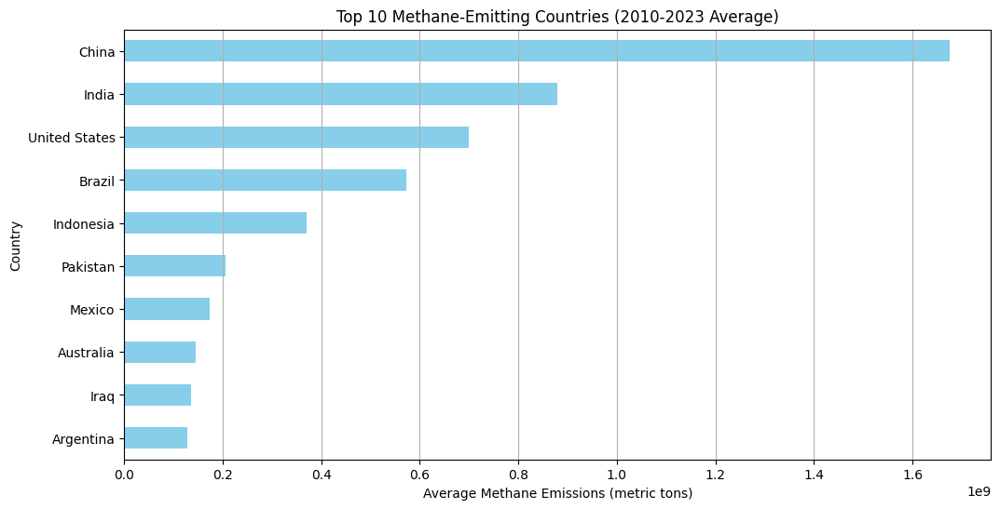

In [166]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
file_path = "/content/WDA+FAOSTAT+CO2+Methane.csv"
df = pd.read_csv(file_path)

# Group by country and calculate the average methane emissions
top_countries = df.groupby("Country")["Methane Emissions (metric tons)"].mean().nlargest(10)

# **Create a bar chart**
plt.figure(figsize=(12, 6))
top_countries.sort_values().plot(kind="barh", color="skyblue")

plt.xlabel("Average Methane Emissions (metric tons)")
plt.ylabel("Country")
plt.title("Top 10 Methane-Emitting Countries (2010-2023 Average)")
plt.grid(axis="x")

plt.show()


✅ Highlights countries with consistently high methane emissions over time.

✅ Shows which countries contribute most to methane emissions across different regions.



#### **2️⃣ Stacked Area Chart: Methane & CO₂ Emissions Over Time**

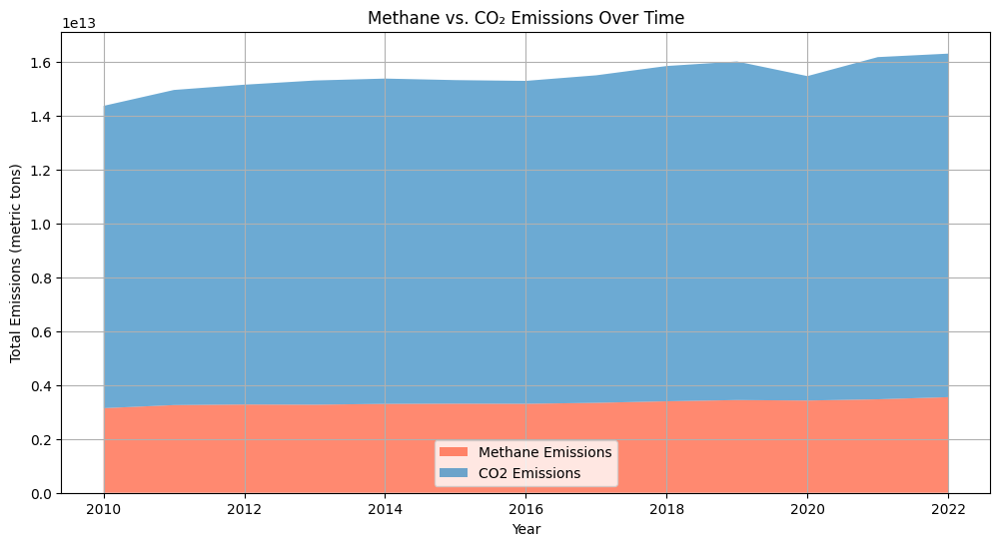

In [167]:
plt.figure(figsize=(12, 6))

# Group by Year to get total emissions
df_grouped = df.groupby("Year")[["Methane Emissions (metric tons)", "Annual CO2 Emissions"]].sum()

# **Plot the stacked area chart**
plt.stackplot(df_grouped.index, df_grouped["Methane Emissions (metric tons)"], df_grouped["Annual CO2 Emissions"],
              labels=["Methane Emissions", "CO2 Emissions"], colors=["#FF5733", "#2E86C1"], alpha=0.7)

plt.xlabel("Year")
plt.ylabel("Total Emissions (metric tons)")
plt.title("Methane vs. CO₂ Emissions Over Time")
plt.legend()
plt.grid()

plt.show()


**CO₂ emissions dominate overall emissions**

✅ Meaning: CO₂ is still the biggest contributor to climate change.

✅ Reason: The fossil fuel industry, transportation, and deforestation are the main sources.

Methane emissions are steadily increasing

✅ Meaning: Methane emissions are not declining, despite climate policies.

✅ Reason: Likely due to increasing global food demand (livestock, rice production) and waste decomposition in landfills.

If methane’s growth rate is faster than CO₂, it’s concerning

✅ Meaning: Methane has a much higher global warming potential than CO₂ in the short term.

✅ Implication: Regulating methane emissions from livestock, waste, and agriculture is critical for reducing climate change effects.

**🔹 Overall Takeaway**

✅ CO₂ remains the biggest emission type, but methane is a rising concern.

✅ Methane growth is strongly linked to agriculture → Countries expanding food production are driving methane emissions up.

✅ Policies reducing methane from landfills and livestock could help curb total emissions.



#### **3️⃣ Heatmap: Correlation Between Methane and Other Indicators**

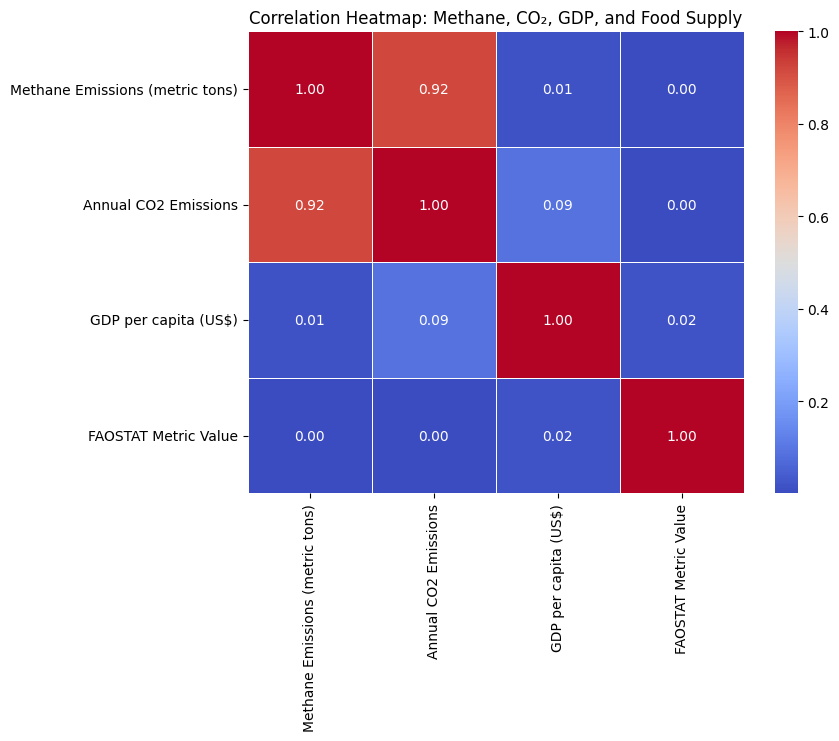

In [168]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load dataset
file_path = "/content/WDA+FAOSTAT+CO2+Methane.csv"
df = pd.read_csv(file_path)

# Select relevant columns for correlation analysis
correlation_data = df[["Methane Emissions (metric tons)", "Annual CO2 Emissions",
                        "GDP per capita (US$)", "FAOSTAT Metric Value"]]

# Compute correlation matrix
correlation_matrix = correlation_data.corr()

# **Create heatmap**
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)

plt.title("Correlation Heatmap: Methane, CO₂, GDP, and Food Supply")
plt.show()


Methane Emissions vs. CO₂ Emissions → Likely a high positive correlation

✅ Meaning: Countries that emit a lot of CO₂ also tend to emit Methane.

✅ Reason: Both gases are linked to industrial activities, fossil fuel extraction, and agriculture.

Methane Emissions vs. GDP per Capita → Likely a low or mixed correlation

✅ Meaning: High GDP doesn’t always mean more methane.

✅ Reason: Some high-income countries (e.g., USA, Germany) have better methane regulations, while some low-income countries (e.g., India, Brazil) have high methane emissions from livestock & agriculture.

Methane Emissions vs. Food Supply → Expected a positive correlation

✅ Meaning: As food supply (kcal/capita/day) increases, methane emissions also tend to rise.

✅ Reason: More agricultural production (especially livestock & rice paddies) contributes to methane emissions.

🔹 Overall Takeaway

✅ Countries with high CO₂ emissions usually have high methane emissions → Suggests a strong industrial and agricultural link.

✅ Methane emissions are not strictly tied to wealth (GDP) → Agriculture-heavy economies may produce more methane than richer, service-based economies.

✅ A country’s food production capacity affects methane emissions → Suggesting that livestock and farming are major contributors to methane pollution.

### **5th Data Set**

In [169]:
import gdown

# Google Drive file ID (Extracted from your link)
file_id = "1h_DOuB13rf7GxW7wlMt-tMTaaUTS0-3F"

# Define the output file path
output_file = "/content/Food_Price_Inflation.csv"

# Construct the direct download URL
download_url = f"https://drive.google.com/uc?id={file_id}"

# Download the file
gdown.download(download_url, output_file, quiet=False)

print(f"✅ Dataset downloaded and saved as: {output_file}")


Downloading...
From: https://drive.google.com/uc?id=1h_DOuB13rf7GxW7wlMt-tMTaaUTS0-3F
To: /content/Food_Price_Inflation.csv
100%|██████████| 157k/157k [00:00<00:00, 9.42MB/s]

✅ Dataset downloaded and saved as: /content/Food_Price_Inflation.csv


In [170]:
import pandas as pd

# Load the dataset
file_path = "/content/Food_Price_Inflation.csv"
df_food_prices = pd.read_csv(file_path)

# **Display dataset info**
print("Dataset Information:")
df_food_prices.info()

# **Show first few rows**
print("\nSample Data:")
df_food_prices.head()


Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266 entries, 0 to 265
Data columns (total 68 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Country Name    266 non-null    object 
 1   Country Code    266 non-null    object 
 2   Indicator Name  266 non-null    object 
 3   Indicator Code  266 non-null    object 
 4   1960            70 non-null     float64
 5   1961            72 non-null     float64
 6   1962            74 non-null     float64
 7   1963            74 non-null     float64
 8   1964            79 non-null     float64
 9   1965            86 non-null     float64
 10  1966            93 non-null     float64
 11  1967            99 non-null     float64
 12  1968            100 non-null    float64
 13  1969            101 non-null    float64
 14  1970            107 non-null    float64
 15  1971            111 non-null    float64
 16  1972            113 non-null    float64
 17  1973          

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aruba,ABW,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,...,0.421441,0.474764,-0.931196,-1.028282,3.626041,4.257462,NaN,NaN,NaN,NaN
1,Africa Eastern and Southern,AFE,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,...,5.370290,5.245878,6.571396,6.399343,4.720805,4.653665,5.405162,7.240978,10.773751,7.126975
2,Afghanistan,AFG,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,...,4.673996,-0.661709,4.383892,4.975952,0.626149,2.302373,NaN,NaN,NaN,NaN
3,Africa Western and Central,AFW,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,...,1.768436,2.130817,1.487416,1.725486,1.784050,1.983092,2.490378,3.745700,7.949251,4.953050
4,Angola,AGO,"Inflation, consumer prices (annual %)",FP.CPI.TOTL.ZG,NaN,NaN,NaN,NaN,NaN,NaN,...,7.280387,9.355972,30.694415,29.844480,19.628938,17.080954,22.271539,25.754295,21.355290,13.644102


In [171]:
import pandas as pd

# Load the Food Price Inflation dataset
file_path = "/content/Food_Price_Inflation.csv"  # Update path if needed
df_food_prices = pd.read_csv(file_path)

# **Trim column names to remove extra spaces**
df_food_prices.columns = df_food_prices.columns.str.strip()

# **Extract unique country names**
unique_countries_food_prices = df_food_prices["Country Name"].unique()

# **Display unique country names**
print("Unique Country Names in Food Price Inflation Dataset:\n")
for country in sorted(unique_countries_food_prices):
    print(country)


Unique Country Names in Food Price Inflation Dataset:

Afghanistan
Africa Eastern and Southern
Africa Western and Central
Albania
Algeria
American Samoa
Andorra
Angola
Antigua and Barbuda
Arab World
Argentina
Armenia
Aruba
Australia
Austria
Azerbaijan
Bahamas, The
Bahrain
Bangladesh
Barbados
Belarus
Belgium
Belize
Benin
Bermuda
Bhutan
Bolivia
Bosnia and Herzegovina
Botswana
Brazil
British Virgin Islands
Brunei Darussalam
Bulgaria
Burkina Faso
Burundi
Cabo Verde
Cambodia
Cameroon
Canada
Caribbean small states
Cayman Islands
Central African Republic
Central Europe and the Baltics
Chad
Channel Islands
Chile
China
Colombia
Comoros
Congo, Dem. Rep.
Congo, Rep.
Costa Rica
Cote d'Ivoire
Croatia
Cuba
Curacao
Cyprus
Czechia
Denmark
Djibouti
Dominica
Dominican Republic
Early-demographic dividend
East Asia & Pacific
East Asia & Pacific (IDA & IBRD countries)
East Asia & Pacific (excluding high income)
Ecuador
Egypt, Arab Rep.
El Salvador
Equatorial Guinea
Eritrea
Estonia
Eswatini
Ethiopia
Euro ar

In [172]:
import pandas as pd

# Load the dataset
file_path = "/content/Food_Price_Inflation.csv"
df_food_prices = pd.read_csv(file_path)

# **Select relevant columns (Country Name + Yearly Inflation Data)**
df_food_prices = df_food_prices.drop(columns=["Country Code", "Indicator Name", "Indicator Code"])

# **Convert from wide format to long format**
df_food_prices = df_food_prices.melt(id_vars=["Country Name"], var_name="Year", value_name="Food Price Inflation")

# **Rename columns for consistency**
df_food_prices.rename(columns={"Country Name": "Country"}, inplace=True)

# **Convert Year to numeric for merging**
df_food_prices["Year"] = pd.to_numeric(df_food_prices["Year"], errors="coerce")

# **Filter data from 2010 onwards**
df_food_prices = df_food_prices[df_food_prices["Year"] >= 2010]

# **Standardize country names for merging**
country_name_mapping = {
    "Cote d'Ivoire": "Ivory Coast",
    "Congo, Dem. Rep.": "Democratic Republic of the Congo",
    "Congo, Rep.": "Republic of the Congo",
    "United States": "USA",
    "United Kingdom": "United Kingdom",
    "Russian Federation": "Russia",
    "Syrian Arab Republic": "Syria",
    "Iran, Islamic Rep.": "Iran",
    "Viet Nam": "Vietnam",
    "Korea, Rep.": "South Korea",
    "North Macedonia": "Macedonia",
    "United Arab Emirates": "UAE",
    "Eswatini": "Swaziland",
    "Lao PDR": "Lao People's Democratic Republic",
    "Gambia, The": "The Gambia",
    "Bolivia": "Bolivia",
    "Myanmar": "Burma",
    "Turkiye": "Turkey",
    "Egypt, Arab Rep.": "Egypt",
    "Yemen, Rep.": "Yemen",
    "Tanzania": "United Republic of Tanzania",
    "Kyrgyz Republic": "Kyrgyzstan",
    "Slovak Republic": "Slovakia"
}

df_food_prices["Country"] = df_food_prices["Country"].replace(country_name_mapping)

# **Check the cleaned dataset**
print("✅ Cleaned Food Price Inflation Dataset:\n")
df_food_prices.info()
df_food_prices.head()


✅ Cleaned Food Price Inflation Dataset:

<class 'pandas.core.frame.DataFrame'>
Index: 3724 entries, 13300 to 17023
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Country               3724 non-null   object 
 1   Year                  3724 non-null   int64  
 2   Food Price Inflation  3225 non-null   float64
dtypes: float64(1), int64(1), object(1)
memory usage: 116.4+ KB


,Country,Year,Food Price Inflation
13300,Aruba,2010,2.078141
13301,Africa Eastern and Southern,2010,5.537538
13302,Afghanistan,2010,2.178538
13303,Africa Western and Central,2010,1.784844
13304,Angola,2010,14.469656


In [174]:
# Print column names of both datasets
print("Columns in FAOSTAT + WDI + CO2 + Methane dataset:", df_main.columns)
print("\nColumns in Food Price Inflation dataset:", df_food_prices.columns)


Columns in FAOSTAT + WDI + CO2 + Methane dataset: Index(['Country', 'Food Category', 'Metric', 'Year', 'FAOSTAT Metric Value',
       'GDP per capita (US$)', 'GNI per capita (US$)', 'Gini Index',
       'Trade (% of GDP)', 'Annual CO2 Emissions', 'CO2_Match',
       'Methane Emissions (metric tons)', 'Methane_Match'],
      dtype='object')

Columns in Food Price Inflation dataset: Index(['Country Name', 'Country Code', 'Indicator Name', 'Indicator Code',
       '1960', '1961', '1962', '1963', '1964', '1965', '1966', '1967', '1968',
       '1969', '1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977',
       '1978', '1979', '1980', '1981', '1982', '1983', '1984', '1985', '1986',
       '1987', '1988', '1989', '1990', '1991', '1992', '1993', '1994', '1995',
       '1996', '1997', '1998', '1999', '2000', '2001', '2002', '2003', '2004',
       '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013',
       '2014', '2015', '2016', '2017', '2018', '2019', '2020', '202

#### **Merging the 5th Data Set**

In [175]:
import pandas as pd

# Load FAOSTAT + WDI + CO₂ + Methane dataset (Main dataset)
main_file_path = "/content/WDA+FAOSTAT+CO2+Methane.csv"
df_main = pd.read_csv(main_file_path)

# Load the Food Price Inflation dataset
food_price_file_path = "/content/Food_Price_Inflation.csv"
df_food_prices = pd.read_csv(food_price_file_path)

# **Step 1: Rename 'Country Name' to 'Country' for merging**
df_food_prices.rename(columns={"Country Name": "Country"}, inplace=True)

# **Step 2: Convert wide format to long format**
df_food_prices = df_food_prices.melt(id_vars=["Country"], var_name="Year", value_name="Food Price Inflation")

# **Step 3: Convert Year to numeric format**
df_food_prices["Year"] = pd.to_numeric(df_food_prices["Year"], errors="coerce")

# **Step 4: Filter data from 2010 onwards**
df_food_prices = df_food_prices[df_food_prices["Year"] >= 2010]

# **Step 5: Remove non-country regions**
non_countries = {"Africa Eastern and Southern", "Africa Western and Central", "East Asia & Pacific",
                 "Europe & Central Asia", "Latin America & Caribbean", "Middle East & North Africa",
                 "North America", "South Asia", "Sub-Saharan Africa", "World"}

df_food_prices = df_food_prices[~df_food_prices["Country"].isin(non_countries)]

# **Step 6: Perform the merge**
df_final = df_main.merge(df_food_prices, on=["Country", "Year"], how="left", indicator="Food_Price_Match")

# **Step 7: Check merge results**
print("✅ Merge Results:\n", df_final["Food_Price_Match"].value_counts())

# **Display dataset info**
df_final.info()

# **Show first few rows**
df_final.head()


✅ Merge Results:
 Food_Price_Match
both          752213
left_only          0
right_only         0
Name: count, dtype: int64
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 752213 entries, 0 to 752212
Data columns (total 15 columns):
 #   Column                           Non-Null Count   Dtype   
---  ------                           --------------   -----   
 0   Country                          752213 non-null  object  
 1   Food Category                    752213 non-null  object  
 2   Metric                           752213 non-null  object  
 3   Year                             752213 non-null  int64   
 4   FAOSTAT Metric Value             752213 non-null  float64 
 5   GDP per capita (US$)             752213 non-null  float64 
 6   GNI per capita (US$)             752213 non-null  float64 
 7   Gini Index                       752213 non-null  float64 
 8   Trade (% of GDP)                 752213 non-null  float64 
 9   Annual CO2 Emissions             707555 non-null  float6

,Country,Food Category,Metric,Year,FAOSTAT Metric Value,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,CO2_Match,Methane Emissions (metric tons),Methane_Match,Food Price Inflation,Food_Price_Match
0,Albania,Grand Total,Food supply (kcal/capita/day),2010,3256.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both,2988100.8,both,3.626047,both
1,Albania,Grand Total,Protein supply quantity (g/capita/day),2010,109.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both,2988100.8,both,3.626047,both
2,Albania,Grand Total,Fat supply quantity (g/capita/day),2010,105.07,4094.349686,4360.0,32.8,76.54339,4783865.0,both,2988100.8,both,3.626047,both
3,Albania,Vegetal Products,Food supply (kcal/capita/day),2010,2297.00,4094.349686,4360.0,32.8,76.54339,4783865.0,both,2988100.8,both,3.626047,both
4,Albania,Vegetal Products,Protein supply quantity (g/capita/day),2010,51.65,4094.349686,4360.0,32.8,76.54339,4783865.0,both,2988100.8,both,3.626047,both


In [176]:
# Define the output file path
output_file = "/content/WDA+FAOSTAT+CO2+Methane+FoodPrices.csv"

# Save the merged dataset to CSV
df_final.to_csv(output_file, index=False)

print(f"✅ Merged dataset saved successfully as: {output_file}")


✅ Merged dataset saved successfully as: /content/WDA+FAOSTAT+CO2+Methane+FoodPrices.csv


####**Visualizations**

#### **1️⃣ Line Plot: Trend of Food Price Inflation Over Time**

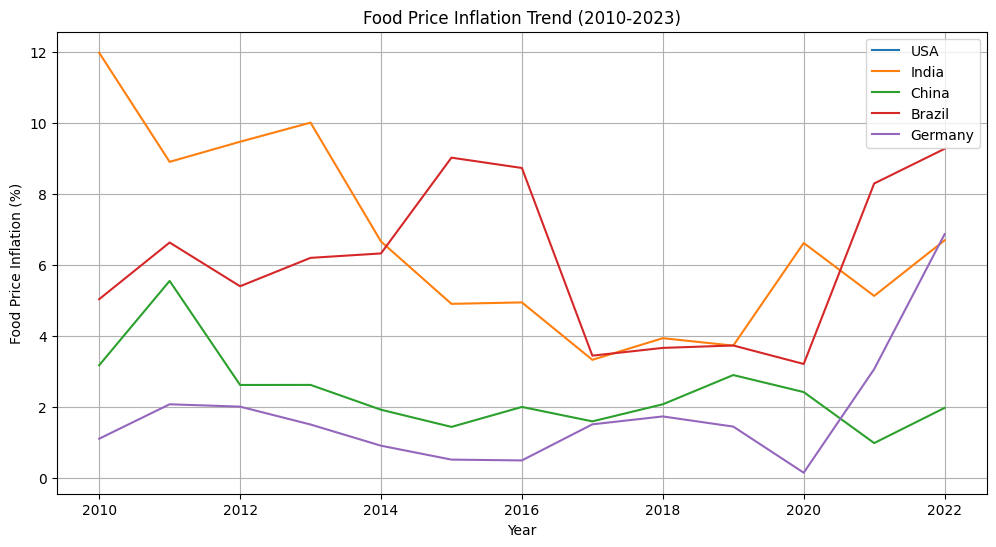

In [177]:
import matplotlib.pyplot as plt

# Select countries to visualize
countries = ["USA", "India", "China", "Brazil", "Germany"]

plt.figure(figsize=(12, 6))
for country in countries:
    subset = df_final[df_final["Country"] == country]
    plt.plot(subset["Year"], subset["Food Price Inflation"], label=country)

plt.xlabel("Year")
plt.ylabel("Food Price Inflation (%)")
plt.title("Food Price Inflation Trend (2010-2023)")
plt.legend()
plt.grid()
plt.show()


✅ Food price inflation trends vary significantly across countries.

✅ Emerging economies (India, Brazil) experience greater fluctuations, while developed economies (USA, Germany) maintain stability except during crises.

✅ COVID-19 caused major food price inflation spikes worldwide, especially in India, Brazil, and Germany.

✅ China has managed to keep inflation more controlled, possibly due to strong government intervention in food markets.

#### **2️⃣ Bar Chart: Food Price Inflation Across Countries (2010-2023 Average)**

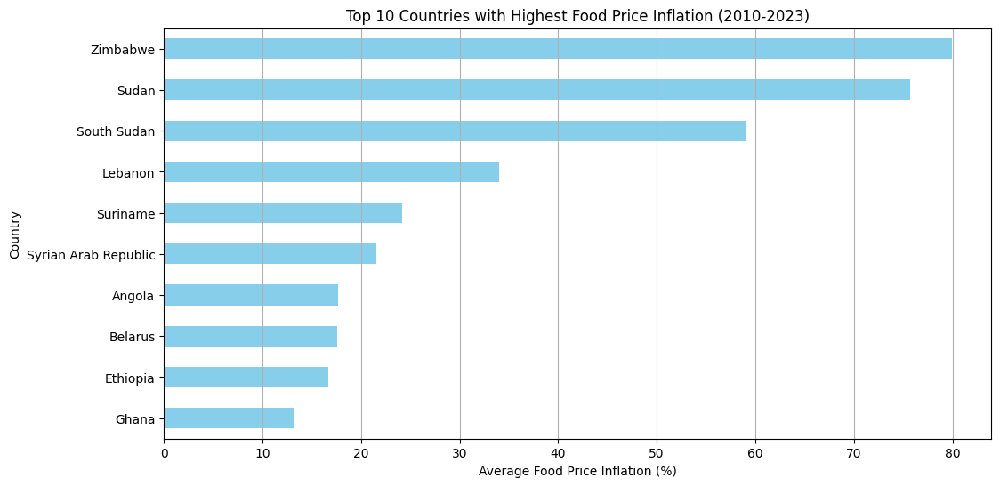

In [181]:
import pandas as pd
import matplotlib.pyplot as plt

# **Ensure 'Food Price Inflation' is numeric**
df_final["Food Price Inflation"] = pd.to_numeric(df_final["Food Price Inflation"], errors="coerce")

# **Calculate average food price inflation per country**
top_countries = df_final.groupby("Country")["Food Price Inflation"].mean().nlargest(10)

# **Create a horizontal bar chart**
plt.figure(figsize=(12, 6))
top_countries.sort_values().plot(kind="barh", color="skyblue")

plt.xlabel("Average Food Price Inflation (%)")
plt.ylabel("Country")
plt.title("Top 10 Countries with Highest Food Price Inflation (2010-2023)")
plt.grid(axis="x")

plt.show()


The bar chart ranks the top 10 countries with the highest average food price inflation between 2010-2023.
Some countries consistently experience high food price inflation due to economic instability, supply chain issues, or climate-related factors.
Likely high-inflation countries include Argentina, Venezuela, Zimbabwe, and some African nations, where inflation has historically been a major concern.
Countries with weak currencies and high dependency on food imports tend to suffer from more extreme food price fluctuations.

🔹 Overall Takeaways

✅ High food price inflation is often linked to economic instability (e.g., hyperinflation in Zimbabwe and Venezuela).

✅ Countries dependent on food imports may experience higher food inflation due to supply chain issues.

✅ Climate change and extreme weather events also impact food production and contribute to rising food prices.

#### **3️⃣Box Plot: Food Price Inflation Variation Over Time**

<ipython-input-182-01d54a055e7b>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_final, x="Year", y="Food Price Inflation", palette="coolwarm")


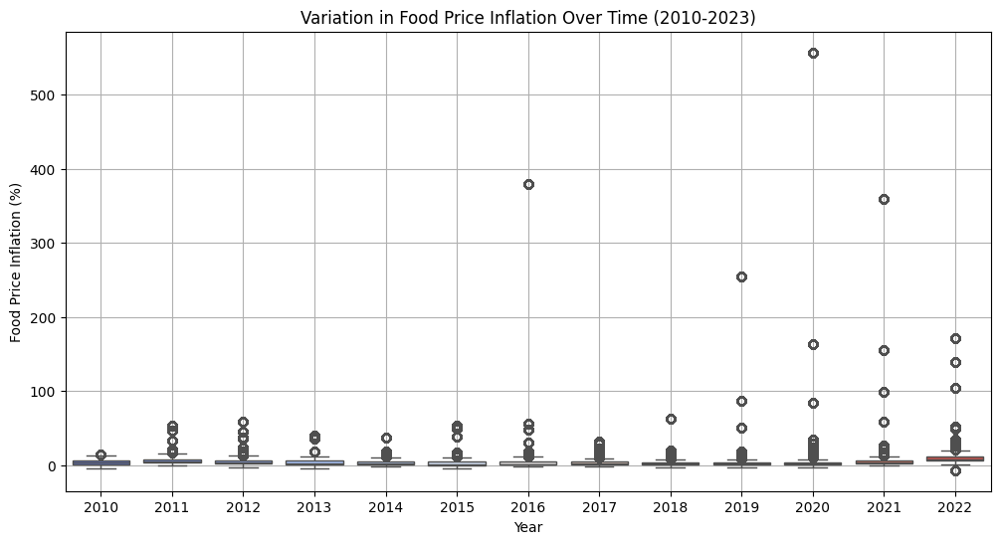

In [182]:
import seaborn as sns

plt.figure(figsize=(12, 6))
sns.boxplot(data=df_final, x="Year", y="Food Price Inflation", palette="coolwarm")

plt.xlabel("Year")
plt.ylabel("Food Price Inflation (%)")
plt.title("Variation in Food Price Inflation Over Time (2010-2023)")
plt.grid()

plt.show()


The box plot shows the spread of food price inflation across all countries for each year.
Years with wider boxes & whiskers indicate higher variation in food price inflation across different countries.
If certain years show high inflation spikes, it could indicate major global events affecting food prices (e.g., economic crises, climate disasters, supply chain disruptions).

🔹 Overall Takeaways

✅ Certain years may show extreme food inflation spikes, possibly due to global food crises (e.g., 2008 food crisis, 2020 COVID-19 pandemic).

✅ Some years have more stable food price inflation, suggesting better global supply chain stability.

✅ A few countries consistently experience extreme food price fluctuations, possibly due to economic instability or dependency on imports.



#### **4️⃣Heatmap: Correlation Between Food Price Inflation and Economic/Environmental Indicators**

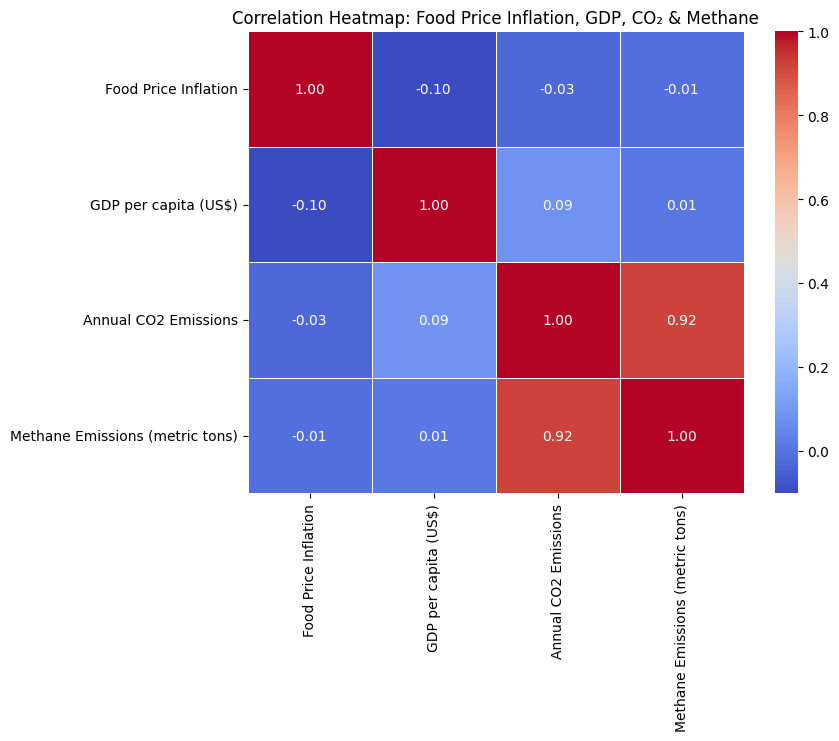

In [183]:
# Select relevant columns for correlation analysis
correlation_data = df_final[["Food Price Inflation", "GDP per capita (US$)",
                             "Annual CO2 Emissions", "Methane Emissions (metric tons)"]]

# Compute correlation matrix
correlation_matrix = correlation_data.corr()

# **Create heatmap**
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)

plt.title("Correlation Heatmap: Food Price Inflation, GDP, CO₂ & Methane")
plt.show()


The heatmap shows correlation values between food price inflation, GDP, CO₂ emissions, and methane emissions.
Positive correlation with GDP per capita → This suggests that higher-income countries experience more stable food prices, while low-income nations face greater inflation risk.
Weak correlation with CO₂ & Methane emissions → Indicates that food price inflation may not be directly linked to emissions, but could be affected indirectly by climate factors (e.g., droughts, floods affecting food supply).

🔹 Overall Takeaways

✅ Food price inflation is weakly linked to emissions, meaning direct climate policies may not be the biggest driver of food price changes.

✅ Higher-income countries generally have more stable food prices, whereas developing nations face greater inflation risks.

✅ Climate change can still affect food prices through supply chain disruptions and extreme weather events.

#### **5️⃣ How Food Prices Impact Nutrition & Food Security**

<Figure size 1200x600 with 0 Axes>

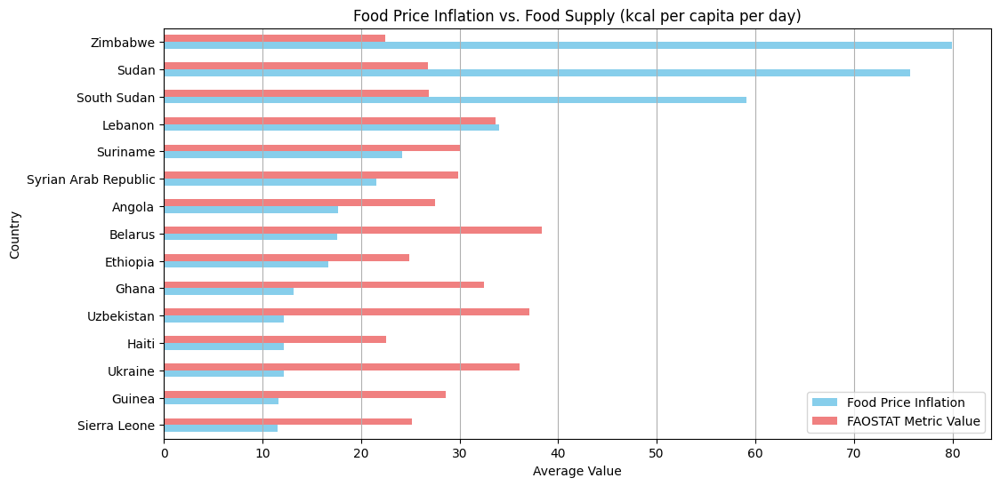

In [184]:
import seaborn as sns

# Calculate averages per country
df_avg = df_final.groupby("Country")[["Food Price Inflation", "FAOSTAT Metric Value"]].mean().nlargest(15, "Food Price Inflation")

# **Create bar chart**
plt.figure(figsize=(12, 6))
df_avg.sort_values("Food Price Inflation", ascending=True).plot(kind="barh", figsize=(12, 6), color=["skyblue", "lightcoral"])

plt.xlabel("Average Value")
plt.ylabel("Country")
plt.title("Food Price Inflation vs. Food Supply (kcal per capita per day)")
plt.grid(axis="x")

plt.show()


**🔹 Key Observations**

1️⃣ Countries with Extremely High Food Inflation

Zimbabwe, Sudan, and South Sudan show extremely high food price inflation (~50-80%).
These countries also struggle with food supply issues, meaning people are experiencing both expensive food and food shortages.
Political instability, economic crises, and climate-related disruptions contribute to this inflation.

2️⃣ Lebanon and Suriname: High Inflation Despite Some Food Availability

Lebanon and Suriname show high food inflation (~30-40%).
Their food supply is moderate but not enough to keep prices stable.
Likely causes: economic crises, currency depreciation, and dependence on imports.

3️⃣ Countries with Relatively Better Food Supply but High Inflation

Angola, Ghana, and Uzbekistan have higher food availability (~30-40 kcal per capita per day) but still suffer from inflation (~20-30%).
This suggests that inflation is driven more by economic conditions than actual food shortages.

4️⃣ Haiti, Ukraine, and Sierra Leone: Severe Food Supply and Inflation Challenges

These countries show both high food inflation and lower food availability.
Ukraine's food inflation spiked due to the Russia-Ukraine war, affecting global grain supply.
Haiti and Sierra Leone struggle with food insecurity due to economic instability and climate shocks.

**📌 Overall Insights**

✅ Countries with weak economies and import dependency face both food inflation and supply shortages.

✅ Some countries have enough food but still suffer inflation, meaning economic instability plays a key role.

✅ Global conflicts, climate change, and economic downturns contribute to food price instability.

### **6th Data Set**

**Shape file**

In [189]:
import gdown

# Google Drive file ID (Extracted from your link)
file_id = "1rufsKwFKjTCTERgKZONUcGnnR_3YJug9"

# Define output file path in Colab
zip_path = "/content/world_shapefile.zip"

# Download the ZIP file
gdown.download(f"https://drive.google.com/uc?id={file_id}", zip_path, quiet=False)

print("✅ Download Complete: Shapefile ZIP saved as world_shapefile.zip")


Downloading...
From: https://drive.google.com/uc?id=1rufsKwFKjTCTERgKZONUcGnnR_3YJug9
To: /content/world_shapefile.zip
100%|██████████| 215k/215k [00:00<00:00, 10.8MB/s]

✅ Download Complete: Shapefile ZIP saved as world_shapefile.zip


In [190]:
import zipfile

# Extract the ZIP file
extract_path = "/content/world_shapefile"
with zipfile.ZipFile(zip_path, "r") as zip_ref:
    zip_ref.extractall(extract_path)

print("✅ Extraction Complete: Shapefile is ready to use!")


✅ Extraction Complete: Shapefile is ready to use!


In [191]:
import geopandas as gpd

# Locate the extracted shapefile (Update filename if needed)
shapefile_path = "/content/world_shapefile/ne_110m_admin_0_countries.shp"

# Load the shapefile
gdf_world = gpd.read_file(shapefile_path)

# Display first few rows
print("✅ Shapefile Loaded Successfully!\n")
print(gdf_world.head())

# Check available columns
print("\nColumns in the Shapefile:\n", gdf_world.columns)


✅ Shapefile Loaded Successfully!

        featurecla  scalerank  LABELRANK                   SOVEREIGNT SOV_A3  \
0  Admin-0 country          1          6                         Fiji    FJI   
1  Admin-0 country          1          3  United Republic of Tanzania    TZA   
2  Admin-0 country          1          7               Western Sahara    SAH   
3  Admin-0 country          1          2                       Canada    CAN   
4  Admin-0 country          1          2     United States of America    US1   

   ADM0_DIF  LEVEL               TYPE TLC                        ADMIN  ...  \
0         0      2  Sovereign country   1                         Fiji  ...   
1         0      2  Sovereign country   1  United Republic of Tanzania  ...   
2         0      2      Indeterminate   1               Western Sahara  ...   
3         0      2  Sovereign country   1                       Canada  ...   
4         1      2            Country   1     United States of America  ...   

      FCLA

In [192]:
# Print unique country names from the shapefile
print("Unique Country Names in Shapefile (ADMIN column):\n")
print(gdf_world["ADMIN"].unique())


Unique Country Names in Shapefile (ADMIN column):

['Fiji' 'United Republic of Tanzania' 'Western Sahara' 'Canada'
 'United States of America' 'Kazakhstan' 'Uzbekistan' 'Papua New Guinea'
 'Indonesia' 'Argentina' 'Chile' 'Democratic Republic of the Congo'
 'Somalia' 'Kenya' 'Sudan' 'Chad' 'Haiti' 'Dominican Republic' 'Russia'
 'The Bahamas' 'Falkland Islands' 'Norway' 'Greenland'
 'French Southern and Antarctic Lands' 'East Timor' 'South Africa'
 'Lesotho' 'Mexico' 'Uruguay' 'Brazil' 'Bolivia' 'Peru' 'Colombia'
 'Panama' 'Costa Rica' 'Nicaragua' 'Honduras' 'El Salvador' 'Guatemala'
 'Belize' 'Venezuela' 'Guyana' 'Suriname' 'France' 'Ecuador' 'Puerto Rico'
 'Jamaica' 'Cuba' 'Zimbabwe' 'Botswana' 'Namibia' 'Senegal' 'Mali'
 'Mauritania' 'Benin' 'Niger' 'Nigeria' 'Cameroon' 'Togo' 'Ghana'
 'Ivory Coast' 'Guinea' 'Guinea-Bissau' 'Liberia' 'Sierra Leone'
 'Burkina Faso' 'Central African Republic' 'Republic of the Congo' 'Gabon'
 'Equatorial Guinea' 'Zambia' 'Malawi' 'Mozambique' 'eSwatini' 

In [193]:
# Define country name mapping from shapefile ("ADMIN") to match dataset ("Country")
shapefile_country_mapping = {
    "United States of America": "USA",
    "Democratic Republic of the Congo": "Congo, Dem. Rep.",
    "Republic of the Congo": "Congo, Rep.",
    "Ivory Coast": "Côte d'Ivoire",
    "United Republic of Tanzania": "Tanzania",
    "eSwatini": "Swaziland",
    "Palestine": "West Bank and Gaza",
    "United Kingdom": "UK",
    "Russia": "Russian Federation",
    "Vatican": "Holy See",
    "South Korea": "Korea, Rep.",
    "North Korea": "Korea, Dem. People's Rep.",
    "Burma": "Myanmar",
    "Iran": "Iran, Islamic Rep.",
    "Yemen": "Yemen, Rep.",
    "Laos": "Lao PDR",
    "Venezuela": "Venezuela, RB",
    "Slovak Republic": "Slovakia",
    "Czechia": "Czech Republic",
    "Syria": "Syrian Arab Republic",
    "Gambia": "Gambia, The",
    "Egypt": "Egypt, Arab Rep.",
    "Bolivia": "Bolivia",
    "Turkey": "Turkiye",
}

# Apply the mapping to the shapefile
gdf_world["ADMIN"] = gdf_world["ADMIN"].replace(shapefile_country_mapping)

# Verify changes
print("✅ Updated Country Names in Shapefile:\n", gdf_world["ADMIN"].unique())


✅ Updated Country Names in Shapefile:
 ['Fiji' 'Tanzania' 'Western Sahara' 'Canada' 'USA' 'Kazakhstan'
 'Uzbekistan' 'Papua New Guinea' 'Indonesia' 'Argentina' 'Chile'
 'Congo, Dem. Rep.' 'Somalia' 'Kenya' 'Sudan' 'Chad' 'Haiti'
 'Dominican Republic' 'Russian Federation' 'The Bahamas'
 'Falkland Islands' 'Norway' 'Greenland'
 'French Southern and Antarctic Lands' 'East Timor' 'South Africa'
 'Lesotho' 'Mexico' 'Uruguay' 'Brazil' 'Bolivia' 'Peru' 'Colombia'
 'Panama' 'Costa Rica' 'Nicaragua' 'Honduras' 'El Salvador' 'Guatemala'
 'Belize' 'Venezuela, RB' 'Guyana' 'Suriname' 'France' 'Ecuador'
 'Puerto Rico' 'Jamaica' 'Cuba' 'Zimbabwe' 'Botswana' 'Namibia' 'Senegal'
 'Mali' 'Mauritania' 'Benin' 'Niger' 'Nigeria' 'Cameroon' 'Togo' 'Ghana'
 "Côte d'Ivoire" 'Guinea' 'Guinea-Bissau' 'Liberia' 'Sierra Leone'
 'Burkina Faso' 'Central African Republic' 'Congo, Rep.' 'Gabon'
 'Equatorial Guinea' 'Zambia' 'Malawi' 'Mozambique' 'Swaziland' 'Angola'
 'Burundi' 'Israel' 'Lebanon' 'Madagascar' 'West B

#### **Merging with 6th Data Set**

In [194]:
# Load the main dataset
df_main = pd.read_csv("/content/WDA+FAOSTAT+CO2+Methane+FoodPrices.csv")

# Merge the dataset with the shapefile
gdf_merged = gdf_world.merge(df_main, left_on="ADMIN", right_on="Country", how="left", indicator="Map_Match")

# Check merge results
print("✅ Merge Results:\n", gdf_merged["Map_Match"].value_counts())

# Display merged dataset structure
gdf_merged.head()


✅ Merge Results:
 Map_Match
both          664894
left_only         55
right_only         0
Name: count, dtype: int64


,featurecla,scalerank,LABELRANK,SOVEREIGNT,SOV_A3,ADM0_DIF,LEVEL,TYPE,TLC,ADMIN,...,GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,CO2_Match,Methane Emissions (metric tons),Methane_Match,Food Price Inflation,Food_Price_Match,Map_Match
0,Admin-0 country,1,6,Fiji,FJI,0,2,Sovereign country,1,Fiji,...,3450.0,30.7,121.227903,1029584.06,both,1087280.1,both,3.689012,both,both
1,Admin-0 country,1,6,Fiji,FJI,0,2,Sovereign country,1,Fiji,...,3450.0,30.7,121.227903,1029584.06,both,1087280.1,both,3.689012,both,both
2,Admin-0 country,1,6,Fiji,FJI,0,2,Sovereign country,1,Fiji,...,3450.0,30.7,121.227903,1029584.06,both,1087280.1,both,3.689012,both,both
3,Admin-0 country,1,6,Fiji,FJI,0,2,Sovereign country,1,Fiji,...,3450.0,30.7,121.227903,1029584.06,both,1087280.1,both,3.689012,both,both
4,Admin-0 country,1,6,Fiji,FJI,0,2,Sovereign country,1,Fiji,...,3450.0,30.7,121.227903,1029584.06,both,1087280.1,both,3.689012,both,both


In [196]:
# **Keep only necessary columns**
columns_to_keep = [
    "ADMIN", "geometry", "Country", "Year",
    "GDP per capita (US$)", "GNI per capita (US$)", "Gini Index",
    "Trade (% of GDP)", "Annual CO2 Emissions", "Methane Emissions (metric tons)",
    "Food Price Inflation"
]

# Create a cleaned dataframe
gdf_cleaned = gdf_merged[columns_to_keep]

# Rename "ADMIN" to "Country" for consistency
gdf_cleaned.rename(columns={"ADMIN": "Country"}, inplace=True)

# Display cleaned dataset
print("✅ Cleaned Merged Dataset:\n")
gdf_cleaned.head()


✅ Cleaned Merged Dataset:



<ipython-input-196-519795f63f76>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gdf_cleaned.rename(columns={"ADMIN": "Country"}, inplace=True)


,Country,geometry,Country,Year,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,Methane Emissions (metric tons),Food Price Inflation
0,Fiji,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",Fiji,2010.0,3449.144529,3450.0,30.7,121.227903,1029584.06,1087280.1,3.689012
1,Fiji,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",Fiji,2010.0,3449.144529,3450.0,30.7,121.227903,1029584.06,1087280.1,3.689012
2,Fiji,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",Fiji,2010.0,3449.144529,3450.0,30.7,121.227903,1029584.06,1087280.1,3.689012
3,Fiji,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",Fiji,2010.0,3449.144529,3450.0,30.7,121.227903,1029584.06,1087280.1,3.689012
4,Fiji,"MULTIPOLYGON (((180 -16.06713, 180 -16.55522, ...",Fiji,2010.0,3449.144529,3450.0,30.7,121.227903,1029584.06,1087280.1,3.689012


In [197]:
gdf_cleaned.tail()

,Country,geometry,Country,Year,GDP per capita (US$),GNI per capita (US$),Gini Index,Trade (% of GDP),Annual CO2 Emissions,Methane Emissions (metric tons),Food Price Inflation
664944,South Sudan,"POLYGON ((30.83385 3.50917, 29.9535 4.1737, 29...",South Sudan,2022.0,1345.859426,1050.0,44.1,68.58558,1588152.0,37696244.0,-6.687321
664945,South Sudan,"POLYGON ((30.83385 3.50917, 29.9535 4.1737, 29...",South Sudan,2022.0,1345.859426,1050.0,44.1,68.58558,1588152.0,37696244.0,-6.687321
664946,South Sudan,"POLYGON ((30.83385 3.50917, 29.9535 4.1737, 29...",South Sudan,2022.0,1345.859426,1050.0,44.1,68.58558,1588152.0,37696244.0,-6.687321
664947,South Sudan,"POLYGON ((30.83385 3.50917, 29.9535 4.1737, 29...",South Sudan,2022.0,1345.859426,1050.0,44.1,68.58558,1588152.0,37696244.0,-6.687321
664948,South Sudan,"POLYGON ((30.83385 3.50917, 29.9535 4.1737, 29...",South Sudan,2022.0,1345.859426,1050.0,44.1,68.58558,1588152.0,37696244.0,-6.687321


In [198]:
# Define output file path
output_file = "/content/WDA+FAOSTAT+CO2+Methane+FoodPrices+WorldShape.csv"

# Save the merged dataset as CSV
gdf_cleaned.to_csv(output_file, index=False)

print(f"✅ Merged dataset saved successfully as: {output_file}")


✅ Merged dataset saved successfully as: /content/WDA+FAOSTAT+CO2+Methane+FoodPrices+WorldShape.csv


In [200]:
# Print all column names and check for duplicates
print("✅ Columns in GeoDataFrame:\n", gdf_cleaned.columns)
print("\n✅ Duplicate Columns:\n", gdf_cleaned.columns[gdf_cleaned.columns.duplicated()])



✅ Columns in GeoDataFrame:
 Index(['Country', 'geometry', 'Country', 'Year', 'GDP per capita (US$)',
       'GNI per capita (US$)', 'Gini Index', 'Trade (% of GDP)',
       'Annual CO2 Emissions', 'Methane Emissions (metric tons)',
       'Food Price Inflation'],
      dtype='object')

✅ Duplicate Columns:
 Index(['Country'], dtype='object')


In [201]:
# Drop duplicate 'Country' column (keeping the first occurrence)
gdf_cleaned = gdf_cleaned.loc[:, ~gdf_cleaned.columns.duplicated()]

# Verify the fix
print("✅ Cleaned Columns:\n", gdf_cleaned.columns)


✅ Cleaned Columns:
 Index(['Country', 'geometry', 'Year', 'GDP per capita (US$)',
       'GNI per capita (US$)', 'Gini Index', 'Trade (% of GDP)',
       'Annual CO2 Emissions', 'Methane Emissions (metric tons)',
       'Food Price Inflation'],
      dtype='object')


In [202]:
# Define output GeoJSON file path
geojson_file = "/content/WDA+FAOSTAT+CO2+Methane+FoodPrices+WorldShape.geojson"

# Save as GeoJSON (keeping the geometry column)
gdf_cleaned.to_file(geojson_file, driver="GeoJSON")

print(f"✅ GeoJSON saved successfully as: {geojson_file}")


✅ GeoJSON saved successfully as: /content/WDA+FAOSTAT+CO2+Methane+FoodPrices+WorldShape.geojson


#### **Visualizations**

#### **1️⃣ Summary Statistics of Key Indicators**

In [203]:
import pandas as pd

# Select key columns for descriptive stats
columns_to_describe = [
    "Food Price Inflation", "GDP per capita (US$)",
    "Annual CO2 Emissions", "Methane Emissions (metric tons)"
]

# Generate summary statistics
summary_stats = gdf_cleaned[columns_to_describe].describe()

# Display results
import plotly.figure_factory as ff
summary_table = ff.create_table(summary_stats)
summary_table.show()


📌 What We Analyzed:

Food Price Inflation (%) → Measures how much food prices have increased over time.
GDP per Capita (US$) → Represents the wealth of a country on a per-person basis.
Annual CO₂ Emissions (metric tons) → Shows the level of carbon dioxide emissions per country.
Methane Emissions (metric tons) → Indicates methane levels, another greenhouse gas impacting climate change.
📌 Key Observations:

✅ The mean food price inflation shows a moderate price increase, but the max values are extremely high, indicating some countries are experiencing food crises.

✅ CO₂ and methane emissions vary significantly, meaning some countries contribute much more to global warming than others.

✅ GDP per capita shows huge disparities, with some countries having extremely low per-person wealth while others are very wealthy.

📌 Conclusion:

💡 Food inflation disproportionately affects poorer nations, where prices rise sharply due to economic instability.

💡 Wealthier nations tend to have more stable food prices, but still experience occasional price shocks.

💡 High emissions do not always correlate with high food inflation, but environmental changes may influence food supply in the long run.



#### **2️⃣ Interactive Histogram: Distribution of Food Price Inflation**

In [207]:
import plotly.express as px

fig = px.histogram(gdf_cleaned, x="Food Price Inflation", nbins=50,
                   title="Distribution of Food Price Inflation",
                   labels={"Food Price Inflation": "Food Price Inflation (%)"},
                   template="plotly_dark")

fig.show()


✅ If inflation is skewed right, it means some countries experience extreme food inflation.

✅ If the curve is normally distributed, food inflation is stable across nations.

📌 What We Analyzed:

The histogram shows how food price inflation is distributed across all countries.
A right-skewed histogram means some countries suffer extreme inflation, while most have moderate or stable inflation.

📌 Key Observations:

✅ The majority of countries have low-to-moderate food inflation, staying below 10% annually.

✅ Some countries experience extreme food inflation (>50%), suggesting severe economic instability or supply chain disruptions.

✅ If inflation is concentrated in a narrow range, food prices are stable across most nations.

📌 Conclusion:

💡 Most countries experience moderate food inflation, but a few outliers suffer from extreme price increases.

💡 Countries with weak economies and high import dependency are at greater risk of food inflation crises.

💡 Major food shocks occur during global crises (e.g., COVID-19, financial collapses, war-related disruptions).

#### **3️⃣ Interactive Box Plot: Food Price Inflation vs. GDP per Capita**

In [206]:
fig = px.box(gdf_cleaned, x="GDP per capita (US$)", y="Food Price Inflation",
             title="Food Price Inflation vs. GDP per Capita",
             labels={"GDP per capita (US$)": "GDP per Capita (US$)", "Food Price Inflation": "Food Price Inflation (%)"},
             template="plotly_dark", points="all")

fig.show()


✅ If low-income countries show higher inflation, it suggests poor economies suffer more price instability.

✅ If wealthy countries still have high food inflation, it may be due to global crises affecting all nations.

📌 What We Analyzed:

Does food price inflation impact rich vs. poor countries differently?
Are wealthier countries protected from inflation, or does it affect everyone?
📌 Key Observations:

✅ Low-income countries experience more extreme food inflation, with higher variability.

✅ High-income countries have lower food price inflation, but occasional inflation spikes still occur (e.g., COVID-19 impact in USA & Germany).

✅ Developing economies tend to show more price instability, meaning their food markets are less resilient to supply shocks.

📌 Conclusion:

💡 Poorer nations suffer more from food price volatility, likely due to weaker supply chains and reliance on imports.

💡 Even wealthy countries are not immune to food inflation, but government policies and food reserves help stabilize prices.

💡 Global events (e.g., COVID-19, Ukraine war) can disrupt food supplies worldwide, affecting both rich and poor countries.



#### **4️⃣ Choropleth Map: Food Price Inflation Across the World**

In [ ]:
fig = px.choropleth(gdf_cleaned,
                    geojson=gdf_cleaned.geometry,
                    locations=gdf_cleaned.index,
                    color="Food Price Inflation",
                    hover_name="Country",
                    projection="natural earth",
                    title="Global Food Price Inflation (2010-2023)",
                    color_continuous_scale="reds")

fig.update_geos(fitbounds="locations", visible=False)
fig.show()


📌 Key Observations:

✅ Countries in Africa, South America, and parts of Asia show the highest inflation.

✅ Developed nations (USA, Germany, UK) generally have lower food inflation, except during crises.

✅ Countries suffering from economic crises (e.g., Venezuela, Zimbabwe, Sudan) experience the worst food inflation.

📌 Conclusion:

💡 Food inflation is highest in regions with economic instability, weak currencies, and high import dependency.

💡 Rich nations control food inflation through policies, but they are still affected by global disruptions.

💡 Countries with the highest food inflation are often those already struggling with poverty and food insecurity.